In [4]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import sys
from sklearn.model_selection import train_test_split

In [2]:
transactions = pd.read_csv('hist_trx.csv')
transactions0 = pd.read_csv('hits0712.csv')
MCC = pd.read_excel('Типы_MCC.XLSX')

In [3]:
transactions = transactions.sort_values(by= ['user_id', 'date_time'],ascending=[True, False])

### Транзакции:

In [93]:
transactions.head(2)

,Unnamed: 0,event_id,date_time,user_id,sub_channel,event_type,sub_type,atm_mcc,mcc_group,atm_merchant_name,amount
245003,4594,6a0e111473c042849b5da90c71c0ea22,2018-12-02 06:14:07,100006366,ISSUER,PAYMENT,EPOS_PURCHASE,9222.0,R,GIBDD.A-3,830.0
343464,6982,e8246963d93b416f9beba58d4e3ecdc4,2018-11-30 09:59:23,100006366,ISSUER_ACQUIRER,DEPOSIT,ATM_CASH,6011.0,Z,ATM 60008355,1000.0


In [335]:
transactions0.head()

,event_id,user_id,rec_user_id,date_time,resolution,sub_channel
0,0fcea7fec4ff479cac8cf37b4555c817,75301207,49913000,2018-12-07 07:56:49,G,ATMAPI
1,c29a4e64d27b435b9b55aa3e62ce54d4,1200695,12797310,2018-12-07 07:14:41,G,MOBILEAPI
2,3107b2b1afcb490ab0a31135eb4b386c,45657780,23814017,2018-12-07 14:02:30,G,MOBILEAPI
3,d9bc95d991144d53b950d8084fa846bf,21683486,9865131,2018-12-07 10:32:41,G,WEBAPI
4,9fc959da4cd144ea8bf5bae2dc041a5e,4531894,VSP15472255,2018-12-07 18:22:52,G,MOBILEAPI


<Figure size 4320x1440 with 0 Axes>

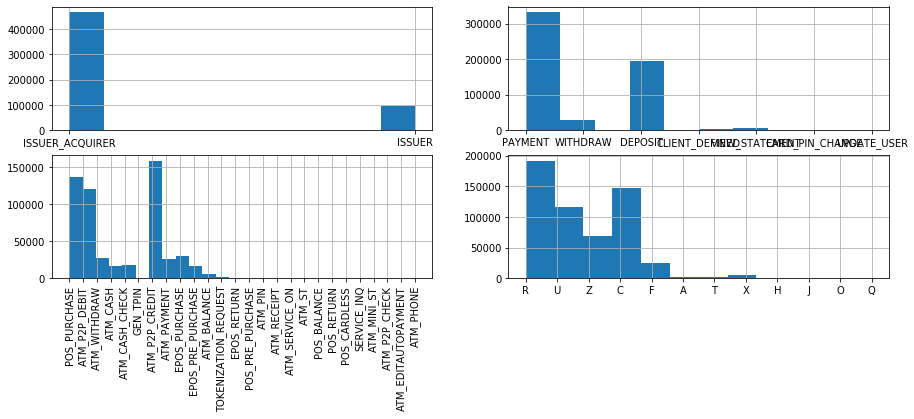

In [147]:
fig, ax = plt.subplots(nrows=2,ncols=2, figsize = (60,20))
transactions.sub_channel.hist(ax=ax[0][0])
transactions.event_type.hist(figsize=(15,5), ax=ax[0][1])
transactions.sub_type.hist(xlabelsize=10, xrot=90,figsize=(15,5),bins=transactions.sub_type.nunique(), ax = ax[1][0])
transactions.mcc_group.hist(figsize=(15,5), bins=transactions.mcc_group.nunique(), ax = ax[1][1])

### Есть смысл посмотреть на распределение этих признаков в классах genue и fraud

In [165]:
fraud_users = transactions0[transactions0.resolution!='G'].user_id
fraud_rec_users = transactions0[transactions0.resolution!='G'].rec_user_id
genue_users = np.hstack((transactions0[transactions0.resolution =='G'].user_id,transactions0[transactions0.resolution =='G'].rec_user_id))
genue_users = set(genue_users)

In [167]:
tr_fr = transactions[transactions.user_id.isin(fraud_users)]
tr_rc_fr = transactions[transactions.user_id.isin(fraud_rec_users)]
tr_gn = transactions[transactions.user_id.isin(genue_users)]

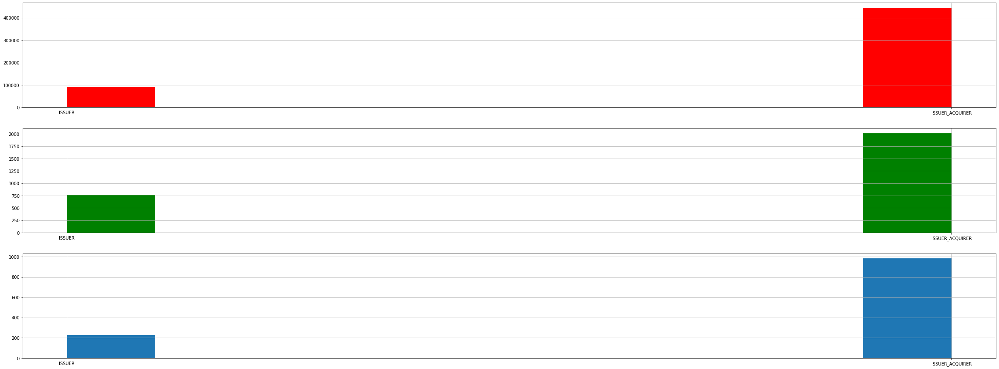

In [490]:
fig, ax = plt.subplots(nrows=3, figsize =(40, 15))
tr_gn.sub_channel.sort_values().hist(color='r', ax= ax[0])
tr_rc_fr.sub_channel.sort_values().hist(color ='g', ax = ax[1])
tr_fr.sub_channel.sort_values().hist(ax = ax[2])

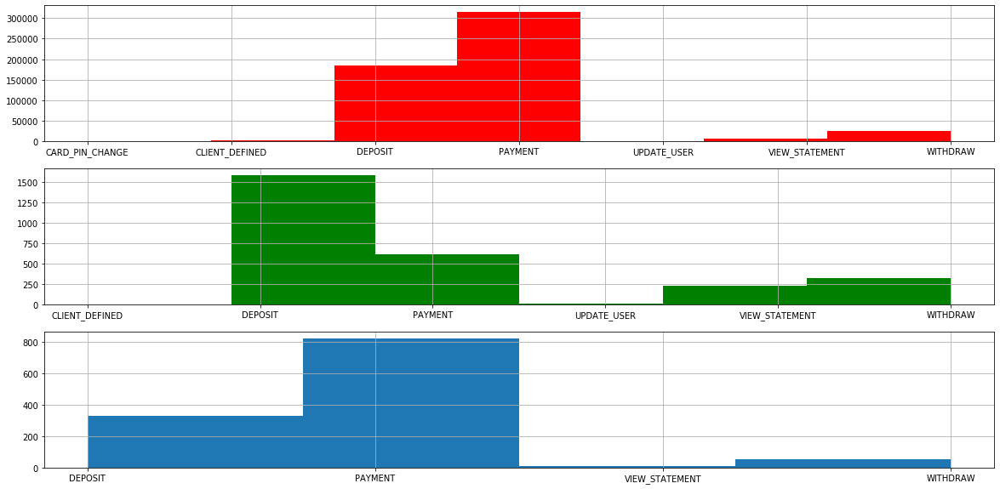

In [189]:
fig, ax = plt.subplots(nrows=3, figsize =(20, 10))
tr_gn.event_type.sort_values().hist(color='r', ax= ax[0], bins = tr_gn.event_type.nunique())
tr_rc_fr.event_type.sort_values().hist(color ='g', ax = ax[1], bins = tr_rc_fr.event_type.nunique())
tr_fr.event_type.sort_values().hist(ax = ax[2], bins = tr_fr.event_type.nunique())

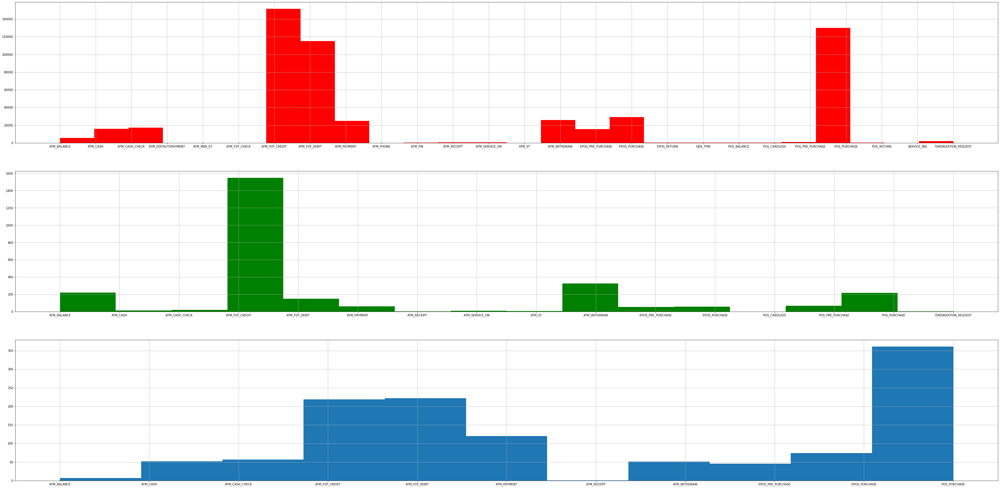

In [185]:
fig, ax = plt.subplots(nrows=3, figsize =(60, 30))
tr_gn.sub_type.sort_values().hist(color='r', ax= ax[0], bins = tr_gn.sub_type.nunique())
tr_rc_fr.sub_type.sort_values().hist(color ='g', ax = ax[1], bins = tr_rc_fr.sub_type.nunique())
tr_fr.sub_type.sort_values().hist(ax = ax[2], bins = tr_fr.sub_type.nunique())

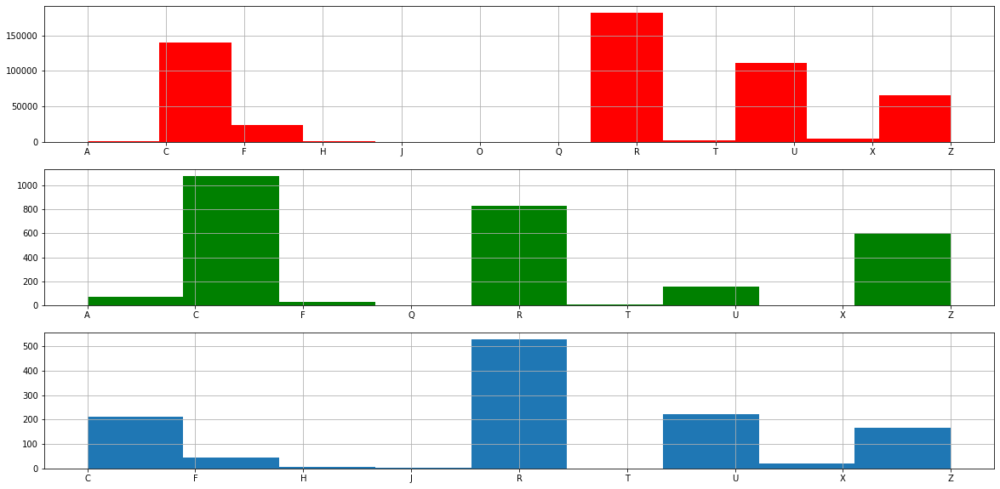

In [190]:
fig, ax = plt.subplots(nrows=3, figsize =(20, 10))
tr_gn.mcc_group.sort_values().hist(color='r', ax= ax[0], bins = tr_gn.mcc_group.nunique())
tr_rc_fr.mcc_group.sort_values().hist(color ='g', ax = ax[1], bins = tr_rc_fr.mcc_group.nunique())
tr_fr.mcc_group.sort_values().hist(ax = ax[2],bins = tr_fr.mcc_group.nunique())

### Резюмирую:
для всех 3 групп, распределения различаются достаточно сильно, прзнаки с наибольшими различиями и используем для подсчета агрегатных функций:
* event_type - deposit и payment распределенны совершенно разно в разных группах
* sub_type - ну и х там много и так видно, а писать лень
* mcc_group 

### Не для всех пользователей из transaction0 есть транзакционные истории в transactions
от них придется избавиться(

In [11]:
usr_hst = set(transactions.user_id)
usr_tr = set(transactions0.user_id)
usr_tr2 = set(transactions0.rec_user_id)
a = set(transactions0[transactions0.user_id.isin(usr_tr-usr_hst)].event_id)|set(transactions0[transactions0.rec_user_id.isin(usr_tr2-usr_hst)].event_id)

Посмотрим сколько данных теряется

In [12]:
tr = transactions0[transactions0.event_id.isin(a)]
print ('потеряно ',len(tr),' объектов, которые составляют', len(tr)/float(len(transactions0)), 'от всего')
print ('потеряно ',len(tr[tr.resolution == 'G']),' объектов класса G, которые составляют', len(tr[tr.resolution == 'G'])/float(len(transactions0[transactions0.resolution=='G'])), 'от всего')
print ('потеряно ',len(tr[tr.resolution != 'G']),' объектов класса F, которые составляют', len(tr[tr.resolution != 'G'])/float(len(transactions0[transactions0.resolution!='G'])), 'от всего')

потеряно  847  объектов, которые составляют 0.09394409937888198 от всего
потеряно  838  объектов класса G, которые составляют 0.09370457340937045 от всего
потеряно  9  объектов класса F, которые составляют 0.1232876712328767 от всего


Теряется 12% фрода! ужасно
надеюсь в полной выборке такого не будет

In [13]:
transactions0 = transactions0.drop(tr.index)

In [14]:
transactions0 = transactions0.drop('Unnamed: 0', axis=1)

In [44]:
target = transactions0.resolution.apply(lambda x: 0 if x=='G' else 1)
tr_tr, tr_tst, target_tr, target_tst = train_test_split(transactions0, target, test_size = 0.5,stratify = target)

In [46]:
(tr_tst.resolution!='G').sum()

32

## Генерируем агрегатные признаки для пар пользователей
а именно следующие:


*  фиксируем время : 24, 48, 72 часа, а также менее 96, но больше 24 часов
*  фиксируем транзакционные признаки
*  для каждого зафиксированного множества строим :мощность множества, суммарные затраты


In [47]:
from datetime import datetime

In [48]:
def hours_diff(t1, t2):
    pattern = '%Y-%m-%d %H:%M:%S'
    tdelta = datetime.strptime(t1, pattern) - datetime.strptime(t2, pattern)
    return tdelta.days*24 + tdelta.seconds//3600

In [49]:
def sec_diff(t1, t2):
    pattern = '%Y-%m-%d %H:%M:%S'
    tdelta = datetime.strptime(t1, pattern) - datetime.strptime(t2, pattern)
    return tdelta.days*24*3600 + tdelta.seconds

In [50]:
from itertools import combinations

def subsets(st):
    subsets = []
    for i in range(len(st)+1):
        for j in combinations(st,i):
            subsets.append(list(j)) 
    return subsets

In [36]:
sub_channel_condition = ['ISSUER']
event_type_conditions = ['DEPOSIT','PAYMENT']
sub_type_conditions = ['ATM_BALANCE','ATM_CASH','ATM_P2P_DEBIT', 'ATM_PAYMENT','POS_PURCHASE','EPOS_PURCHASE']
mcc_cat_conditions = ['A','U','Z']

In [37]:
sub_s_sub_channel = subsets(sub_channel_condition)
sub_s_ev_type = subsets(event_type_conditions)
sub_s_type = subsets(sub_type_conditions)
sub_s_mcc = subsets(mcc_cat_conditions)

sub_s_sub_channel.append(list(transactions.sub_channel.unique()))
sub_s_ev_type.append(list(transactions.event_type.unique()))
sub_s_type.append(list(transactions.sub_type.unique()))
sub_s_mcc.append(list(transactions.mcc_group.unique()))

for sub_s in [sub_s_sub_channel, sub_s_ev_type, sub_s_type, sub_s_mcc]:
    sub_s.remove([])

В общем идея того как эти фичи считать следующая (вроде как быстрее должно быть чем тупо в цикле, хоть все равно в цикле): у нас получается есть 2^12 разных раборов значений для признаков, для которых транзакции мы будем считать, так собственно сделаем для них маски


In [38]:
masks = []

for sub_ch in sub_s_sub_channel:
    for ev_t in sub_s_ev_type:
        for s_t in sub_s_type:
            for mcc in sub_s_mcc:
                masks.append(transactions.sub_channel.isin(sub_ch)&
                           transactions.event_type.isin(ev_t)&
                           transactions.sub_type.isin(s_t)&
                           transactions.mcc_group.isin(mcc))

In [197]:
print(len(masks[0])*len(masks)/2**20, 'мб занимает')

NameError: name 'masks' is not defined

In [259]:
agg_features = []

for ev_id,us_id, rec_us_id, d_t in transactions0[['event_id','user_id','rec_user_id','date_time']].values:
    us_mask24 = transactions[['user_id','date_time']].apply(lambda x: True if x[0] in [us_id, rec_us_id] and 
                                                            diff(d_t,x[1])<=24 and 
                                                            diff(d_t,x[1])>=0, axis = 1)
    us_mask48 = transactions[['user_id','date_time']].apply(lambda x: True if x[0] in [us_id, rec_us_id] and 
                                                            diff(d_t,x[1])<=48 and 
                                                            diff(d_t,x[1])>=0, axis = 1)
    us_mask72 = transactions[['user_id','date_time']].apply(lambda x: True if x[0] in [us_id, rec_us_id] and 
                                                            diff(d_t,x[1])<=72 and 
                                                            diff(d_t,x[1])>=0, axis = 1)
    us_mask96 = transactions[['user_id','date_time']].apply(lambda x: True if x[0] in [us_id, rec_us_id] and 
                                                            diff(d_t,x[1])<=96 and 
                                                            diff(d_t,x[1])>=24, axis = 1)
    features = []
    features.append(ev_id)
    for cat_mask in masks:
        for time_mask in [us_mask24,us_mask48,us_mask72,us_mask96]
            mask = time_mask&cat_mask
            features.append(transactions[mask].groupby('user_id').agg(['sum','count']).amount.values.ravel())
    agg_features.append(features)

'2018-12-07 07:56:49'

## Восстановим распределение времени  покупок в течении дня
Распрделение для каждого пользователя будем приближать распределением Мизеса-Фишера, которое является переодическим аналогом нормального распределения, параметры считаются следующим образом:
$$D\sim Vonmises(\mu, \frac{1}{\sigma})$$

$$\mu = 2\arctan(\frac{\sum_{t_j\in D}\sin(t_j)}{\sqrt{(\sum_{t_j\in D}\sin(t_j))^2+(\sum_{t_j\in D}\cos(t_j))^2}+(\sum_{t_j\in D}\cos(t_j))^2})$$
$$\sigma = \sqrt{\ln{\frac{1}{(\frac{1}{N}\sum_{t_j\in D}\sin(t_j))^2+(\frac{1}{N}\sum_{t_j\in D}\cos(t_j))^2}}}$$

Далее, строю доверительные интервалы и смотрю, попадает ли туда наше значение.


/TODO Еще можно по дням недели восстановить распределения, все-таки транзакции по воскресениям могут сильно различаться от тех что по средам. Также можно посчитать,параметры по последним 24 часам и по тем что были позже этим 24 часов и проверить гипотезы о равенстве параметров, получившийся p-value - новый признак

ЗЫ меня беспокоет, что если считать распределение по всем транзакциям, то ,тк они не размеченны, есть шанс учесть в распределении и мошеннеческие транзакции. Может стоит обрезать,например, первые n транзакций? Или вычислять это n... Жду советов

In [51]:
from scipy.stats import vonmises_line

In [52]:
def calculate_hours(time_list):
    
    '''Функция возвращает список моментов времени в часах, от 0:00, отображенный на отрезок [0;2Pi]'''
    
    pattern = '%Y-%m-%d %H:%M:%S'
    starting_time = datetime.strptime('2019-01-01 0:0:0', pattern)
    dtime_list = []
    for time in time_list:
        d = starting_time - datetime.strptime(time, pattern)
        dtime_list.append(d.seconds/3600)
    return np.array(dtime_list)/12*np.pi
    #return dtime_list

In [53]:
def return_hours(time):
    '''Функция возвращает список моментов времени в часах, от 0:00, отображенный на отрезок [0;24], принимая [-2Pi;2Pi]'''
    if time>0:
        return time*12/np.pi
    return (time+2*np.pi)*12/np.pi

In [54]:
def is_in_interval(interval, values):
    counter=0
    l = return_hours(interval[0])
    r = return_hours(interval[1])
    if l<r:
        for v in iter(values):
            if return_hours(v)> l and return_hours(v)<r:
                counter+=1
    else:
        for v in iter(values):
            if return_hours(v)> l or return_hours(v)<r:
                counter+=1
    return counter

In [55]:
def calculate_periodic_mean(dtime_list):
    dtime_list = np.array(dtime_list)
    sin = np.sin(dtime_list).sum()
    cos = np.cos(dtime_list).sum()
    mean = sin/(np.sqrt(np.power(sin,2)+np.power(cos,2))+cos)
    return 2*np.arctan(mean)

In [56]:
def calculate_periodic_std(dtime_list):
    dtime_list = np.array(dtime_list)
    sin = np.sin(dtime_list).mean()
    cos = np.cos(dtime_list).mean()
    std = np.sqrt(np.log(1/(np.power(sin,2)+np.power(cos,2))))
    return std

In [509]:
time_fetures = np.zeros((transactions0.shape[0], 20), dtype=np.float128)
for user in enumerate(usrs):
    i = user[0]
    dt1 = calculate_hours(transactions[transactions.user_id == user[1][0]].date_time)
    dt2 = calculate_hours(transactions[transactions.user_id == user[1][1]].date_time)
    mean1 = calculate_periodic_mean(dt1)
    std1 = calculate_periodic_std(dt1)
    mean2 = calculate_periodic_mean(dt2)
    std2 = calculate_periodic_std(dt2)
    vonms1 = vonmises_line(kappa = 1/std1, loc= mean1)
    vonms2 = vonmises_line(kappa = 1/std2, loc = mean2)
    time_fetures[i][0] = mean1
    time_fetures[i][1] = std1
    time_fetures[i][10] = mean2
    time_fetures[i][11] = std2
    for alpha in enumerate([0.9,0.8,0.7,0.6]):
        inter1 = vonms1.interval(alpha[1])
        inter2 = vonms2.interval(alpha[1])
        time_fetures[i][2+2*alpha[0]] = inter1[0]
        time_fetures[i][2+2*alpha[0]+1] = inter1[1]
        time_fetures[i][12+2*alpha[0]] = inter2[0]
        time_fetures[i][12+2*alpha[0]+1] = inter2[1]

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in double_scalars
  # This is added back by InteractiveShellApp.init_path()
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/scipy/stats/_continuous_distns.py:6724: RuntimeWarning: divide by zero encountered in true_divide
  return _stats.von_mises_cdf(kappa, x)
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: divide by zero encountered in double_scalars
  # Remove the CWD from sys.path while we load stuff.
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: invalid value encountered in sqrt
  """


In [61]:
time_fetures = pd.read_pickle('alf.pkl')
time_fetures.head()

,mu1,std1,alpha1_l_0.9,alpha1_r_0.9,alpha1_l_0.8,alpha1_r_0.8,alpha1_l_0.7,alpha1_r_0.7,alpha1_l_0.6,alpha1_r_0.6,mu2,std2,alpha2_l_0.9,alpha2_r_0.9,alpha2_l_0.8,alpha2_r_0.8,alpha2_l_0.7,alpha2_r_0.7,alpha2_l_0.6,alpha2_r_0.6
0,2.373196,1.031969,0.136550,4.609841,0.693829,4.052562,1.057580,3.688812,1.328508,3.417884,2.449570,0.000000,2.449570,2.449570,2.449570,2.449570,2.449570,2.449570,2.449570,2.449570
1,3.012235,0.710980,1.181126,4.843344,1.671659,4.352811,1.962768,4.061702,2.176857,3.847614,-1.873205,0.609098,-3.515796,-0.230613,-3.079771,-0.666638,-2.821405,-0.925004,-2.629988,-1.116421
2,-2.140792,0.002036,-2.215051,-2.066533,-2.198644,-2.082940,-2.187576,-2.094007,-2.178781,-2.102802,3.001643,0.588725,1.399622,4.603664,1.823087,4.180200,2.074531,3.928756,2.261223,3.742064
3,-2.176786,0.801601,-4.151356,-0.202216,-3.626517,-0.727055,-3.309804,-1.043767,-3.077239,-1.276332,-2.719502,0.731645,-4.585453,-0.853550,-4.085861,-1.353143,-3.788587,-1.650417,-3.570131,-1.868872
4,-3.000383,1.395395,-5.453463,-0.547302,-4.920052,-1.080714,-4.525177,-1.475589,-4.217027,-1.783739,-2.648545,1.254632,-5.036828,-0.260262,-4.489816,-0.807274,-4.102348,-1.194741,-3.805729,-1.491360


У нас есть доверительные интервалы, значит можем посчитать какое количество транзакций из последних 5 (отсчитывается от даты транзакции) попадает в заданные интервалы

### Также, восстановим распределение не для каждого, а для всех genue и fraud пользователей

In [57]:
scl = 12/np.pi

genue_usrs = tr_tr[tr_tr.resolution=='G'][['user_id', 'rec_user_id']].values.ravel()
fraud_usrs = tr_tr[tr_tr.resolution!='G'].user_id
rec_fraud_usrs = tr_tr[tr_tr.resolution!='G'].rec_user_id

genue_hours = calculate_hours(transactions[transactions.user_id.isin(genue_usrs)].date_time)
fraud_hours = calculate_hours(transactions[transactions.user_id.isin(fraud_usrs)].date_time)
rec_fraud_hours = calculate_hours(transactions[transactions.user_id.isin(rec_fraud_usrs)].date_time)

genue_distr = vonmises_line(kappa = 1/calculate_periodic_std(genue_hours), loc= calculate_periodic_mean(genue_hours))
fraud_distr = vonmises_line(kappa = 1/calculate_periodic_std(fraud_hours), loc= calculate_periodic_mean(fraud_hours))
rec_fraud_distr = vonmises_line(kappa = 1/calculate_periodic_std(rec_fraud_hours), loc= calculate_periodic_mean(rec_fraud_hours))

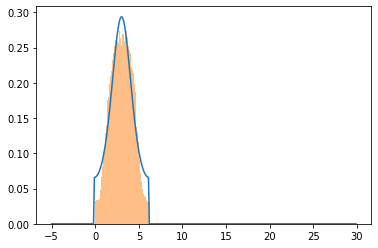

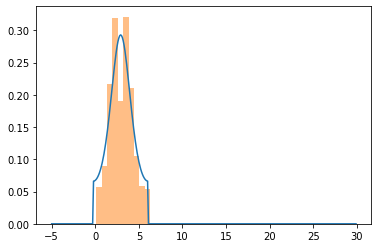

(array([0.11078835, 0.17707197, 0.22725815, 0.26892214, 0.20547924,
        0.16192143, 0.16665597, 0.08616871, 0.11268216, 0.07764653]),
 array([3.92699082e-03, 6.31045608e-01, 1.25816422e+00, 1.88528284e+00,
        2.51240146e+00, 3.13952008e+00, 3.76663869e+00, 4.39375731e+00,
        5.02087593e+00, 5.64799454e+00, 6.27511316e+00]),
 <a list of 10 Patch objects>)

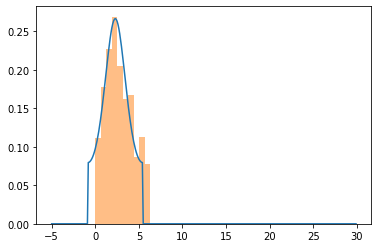

In [59]:
x = np.arange(-5,30,0.1)
plt.plot(x,genue_distr.pdf(x))
plt.hist(genue_hours,density=True, alpha=0.5, bins= 200)
plt.show()
plt.plot(x,fraud_distr.pdf(x))
plt.hist(fraud_hours,density=True, alpha=0.5, bins= 10)
plt.show()
plt.plot(x,rec_fraud_distr.pdf(x))
plt.hist(rec_fraud_hours,density=True, alpha=0.5, bins= 10)

In [60]:
genue_intervals = np.zeros((4,2))
fraud_intervals = np.zeros((4,2))
rec_fraud_intervals = np.zeros((4,2))
for alpha in enumerate([0.9,0.8,0.7,0.6]):
        inter1 = genue_distr.interval(alpha[1])
        inter2 = fraud_distr.interval(alpha[1])
        inter3 = rec_fraud_distr.interval(alpha[1])
        
        genue_intervals[alpha[0]][0] = inter1[0]
        genue_intervals[alpha[0]][1] = inter1[1]
        fraud_intervals[alpha[0]][0] = inter2[0]
        fraud_intervals[alpha[0]][1] = inter2[1]
        rec_fraud_intervals[alpha[0]][0] = inter3[0]
        rec_fraud_intervals[alpha[0]][1] = inter3[1]

Среднее для мошенников и нормальных людей ну явно различается, получается можно использовать как еще одни признаки попадание в предсказательный интервал для данного распределения

### Посчитаем количество попаданий в интервалы в последних 5 и 10 транзакциях и транзакции из размеченной таблицы

In [62]:
us_intervals = pd.concat([time_fetures[['alpha1_l_0.9',
                              'alpha1_r_0.9',
                              'alpha1_l_0.8',
                              'alpha1_r_0.8',
                              'alpha1_l_0.7',
                              'alpha1_r_0.7',
                              'alpha1_l_0.6',
                              'alpha1_r_0.6']], transactions0.user_id],axis=1)

rec_us_intervals = pd.concat([time_fetures[['alpha2_l_0.9',
                                  'alpha2_r_0.9',
                                  'alpha2_l_0.8',
                                  'alpha2_r_0.8',
                                  'alpha2_l_0.7',
                                  'alpha2_r_0.7',
                                  'alpha2_l_0.6',
                                  'alpha2_r_0.6']], transactions0.rec_user_id],axis=1)

In [63]:
interval_features = []

for us1, us2, dt in tr_tst[['user_id', 'rec_user_id', 'date_time']].values:
    int_feat = []
    trans1 = transactions[(transactions.user_id==us1)&(transactions.date_time<dt)].date_time
    trans2 = transactions[(transactions.user_id==us2)&(transactions.date_time<dt)].date_time
    
    int1 = us_intervals[us_intervals.user_id == us1].values[0][:-1].reshape((4,2))
    int2 = rec_us_intervals[rec_us_intervals.rec_user_id == us2].values[0][:-1].reshape((4,2))
    
    for tp in [int1,genue_intervals,fraud_intervals,rec_fraud_intervals]:
        for intr in tp:
            int_feat.append(is_in_interval(intr, calculate_hours(trans1.iloc[:5])))
            int_feat.append(is_in_interval(intr, calculate_hours(trans1.iloc[:10])))
            
    for tp in [int2,genue_intervals,fraud_intervals,rec_fraud_intervals]:
        for intr in tp:
            int_feat.append(is_in_interval(intr, calculate_hours(trans2.iloc[:5])))
            int_feat.append(is_in_interval(intr, calculate_hours(trans2.iloc[:10])))
    
    interval_features.append(int_feat)


In [64]:
np.save('time_features',np.array(interval_features))

In [65]:
time_features = pd.DataFrame(np.load('time_features.npy'))

In [66]:
time_features

,0,1,2,3,4,5,6,7,8,9,...,54,55,56,57,58,59,60,61,62,63
0,5,9,5,9,5,9,5,8,5,10,...,4,9,5,10,4,9,4,9,4,9
1,5,10,4,9,2,7,2,5,5,10,...,5,10,5,10,5,10,5,10,5,10
2,5,10,5,8,5,7,5,7,5,10,...,2,6,4,9,2,6,2,6,2,6
3,4,8,4,8,4,7,4,7,4,8,...,0,3,5,10,5,10,5,9,4,7
4,5,6,5,6,5,6,4,5,5,6,...,5,7,5,8,5,7,5,6,5,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4080,3,3,3,3,3,3,2,2,3,3,...,2,7,5,10,5,10,3,8,3,8
4081,5,10,5,9,2,6,2,5,5,10,...,4,4,5,5,5,5,5,5,5,5
4082,5,10,5,10,5,10,4,9,5,10,...,0,5,5,10,5,10,5,10,5,10
4083,5,9,5,9,5,9,5,9,5,10,...,4,9,5,10,5,10,5,10,5,10


## Фичи на основе скрытых марковских моделей
Считаем что количество потраченных денег или разность во времени между соседними транзакциями это наблюдаемые состояния, на их основе будем моделировать процесс. Далее будем считать правдоподобие транзакционной истории.
Считаем на основе транзакций:
* С карт не мошеннических пользователей
* С карт мошенников
* С карт попавших в руки мошенников

In [90]:
from hmmlearn import hmm

In [68]:
genue_lenghts = transactions[transactions.user_id.isin(genue_usrs)].groupby('user_id').user_id.count().values
genue_amounts = transactions[transactions.user_id.isin(genue_usrs)].sort_values(by='user_id').amount.values
genue_amounts = genue_amounts.reshape((len(genue_amounts),1))

fraud_lenghts = transactions[transactions.user_id.isin(fraud_usrs)].groupby('user_id').user_id.count().values
fraud_amounts = transactions[transactions.user_id.isin(fraud_usrs)].sort_values(by='user_id').amount.values
fraud_amounts = fraud_amounts.reshape((len(fraud_amounts),1))

rec_fraud_lenghts = transactions[transactions.user_id.isin(rec_fraud_usrs)].groupby('user_id').user_id.count().values
rec_fraud_amounts = transactions[transactions.user_id.isin(rec_fraud_usrs)].sort_values(by='user_id').amount.values
rec_fraud_amounts = rec_fraud_amounts.reshape((len(rec_fraud_amounts),1))

In [69]:
genue_times = transactions[transactions.user_id.isin(genue_usrs)].sort_values(by= ['user_id', 'date_time'],ascending=[True, False]).date_time.values
t_delta_genue = []
count = 0
for leng in genue_lenghts:
    for n in range(0,leng-1):
        t_delta_genue.append([sec_diff(genue_times[count+n], genue_times[count+n+1])])
    count+=leng

In [70]:
fraud_times = transactions[transactions.user_id.isin(fraud_usrs)].sort_values(by= ['user_id', 'date_time'],ascending=[True, False]).date_time.values
t_delta_fraud = []
count = 0
for leng in fraud_lenghts:
    for n in range(0,leng-1):
        t_delta_fraud.append([sec_diff(fraud_times[count+n], fraud_times[count+n+1])])
    count+=leng

In [71]:
rec_fraud_times = transactions[transactions.user_id.isin(rec_fraud_usrs)].sort_values(by= ['user_id', 'date_time'],ascending=[True, False]).date_time.values
t_delta_rec_fraud = []
count = 0
for leng in rec_fraud_lenghts:
    for n in range(0,leng-1):
        t_delta_rec_fraud.append([sec_diff(rec_fraud_times[count+n], rec_fraud_times[count+n+1])])
    count+=leng

#### Посмотрим сколько компонент стоит использовать

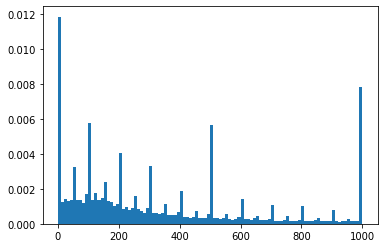

In [115]:
plt.hist(genue_amounts, range=(0,1000), bins=100, density=True)
plt.show()

получилось некоторое говно

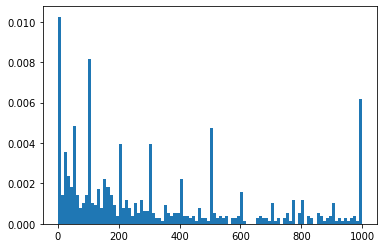

In [116]:
plt.hist(fraud_amounts, range=(0,1000), bins=100,density=True)
plt.show()

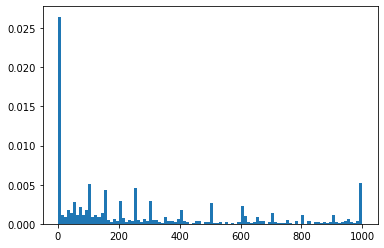

In [117]:
plt.hist(rec_fraud_amounts, range=(0,1000), bins=100,density=True)
plt.show()

Если честно, то вообще не похоже на смесь нормальных распределенй, надо попробовать разбить на интервалы и смотреть распределение по ним

### Предполагаем что распределения нормальные

In [118]:
genue_hmm = hmm.GaussianHMM(n_components=10, covariance_type="full", n_iter=100)
genue_hmm.fit(genue_amounts, genue_lenghts)

GaussianHMM(algorithm='viterbi', covariance_type='full', covars_prior=0.01,
            covars_weight=1, init_params='stmc', means_prior=0, means_weight=0,
            min_covar=0.001, n_components=10, n_iter=100, params='stmc',
            random_state=None, startprob_prior=1.0, tol=0.01,
            transmat_prior=1.0, verbose=False)

In [113]:
fraud_hmm = hmm.GaussianHMM(n_components=10, covariance_type="full", n_iter=1000)
fraud_hmm.fit(fraud_amounts, fraud_lenghts)

GaussianHMM(algorithm='viterbi', covariance_type='full', covars_prior=0.01,
            covars_weight=1, init_params='stmc', means_prior=0, means_weight=0,
            min_covar=0.001, n_components=10, n_iter=1000, params='stmc',
            random_state=None, startprob_prior=1.0, tol=0.01,
            transmat_prior=1.0, verbose=False)

In [114]:
rec_fraud_hmm = hmm.GaussianHMM(n_components=10, covariance_type="full", n_iter=1000)
rec_fraud_hmm.fit(rec_fraud_amounts, rec_fraud_lenghts)

GaussianHMM(algorithm='viterbi', covariance_type='full', covars_prior=0.01,
            covars_weight=1, init_params='stmc', means_prior=0, means_weight=0,
            min_covar=0.001, n_components=10, n_iter=1000, params='stmc',
            random_state=None, startprob_prior=1.0, tol=0.01,
            transmat_prior=1.0, verbose=False)

In [168]:
likehoods = []
for hmm in [genue_hmm, fraud_hmm, rec_fraud_hmm]:
    likehood = []
    for sample in zip([genue_amounts,fraud_amounts,rec_fraud_amounts],[genue_lenghts,fraud_lenghts,rec_fraud_lenghts]):
        likehood_s = []
        cum = 0
        for l in sample[1]:
            likehood_s.append(hmm.score(sample[0][cum:cum+l]))
            cum+=l
        likehood.append(likehood_s)
    likehoods.append(likehood)

In [44]:
def likehood_statistic(likehoods, range_ = (-3000,10)):
    for likehood in likehoods:
        likehood_g = np.array(likehood[0])
        likehood_f = np.array(likehood[1])
        likehood_r_f = np.array(likehood[2])
        print(likehood_g.mean(),likehood_g.std())
        print(likehood_f.mean(),likehood_f.std())
        print(likehood_r_f.mean(),likehood_r_f.std())
        print('---------')
    
    fig, ax = plt.subplots(ncols=3,nrows=3,figsize = (20,20))
    for i in range(3):
        for j in range(3):
            ax[i][j].hist(likehoods[i][j],
                          density=True,range= range_,
                          bins = 7*int(np.log(len(likehoods[i][j]))),
                         log = False)

-352.6467585125818 683.5885057633388
-204.68899430756707 177.7588223258147
-555.1430062828881 976.7646553631048
---------
-857.9646017755798 30833.211048859448
-195.7610767512327 171.16713562674636
-616.9266195340293 1156.2129298145544
---------
-472.27873334116157 7895.7427086323305
-208.61038210633058 182.59117395162963
-542.498368289025 928.726742976025
---------


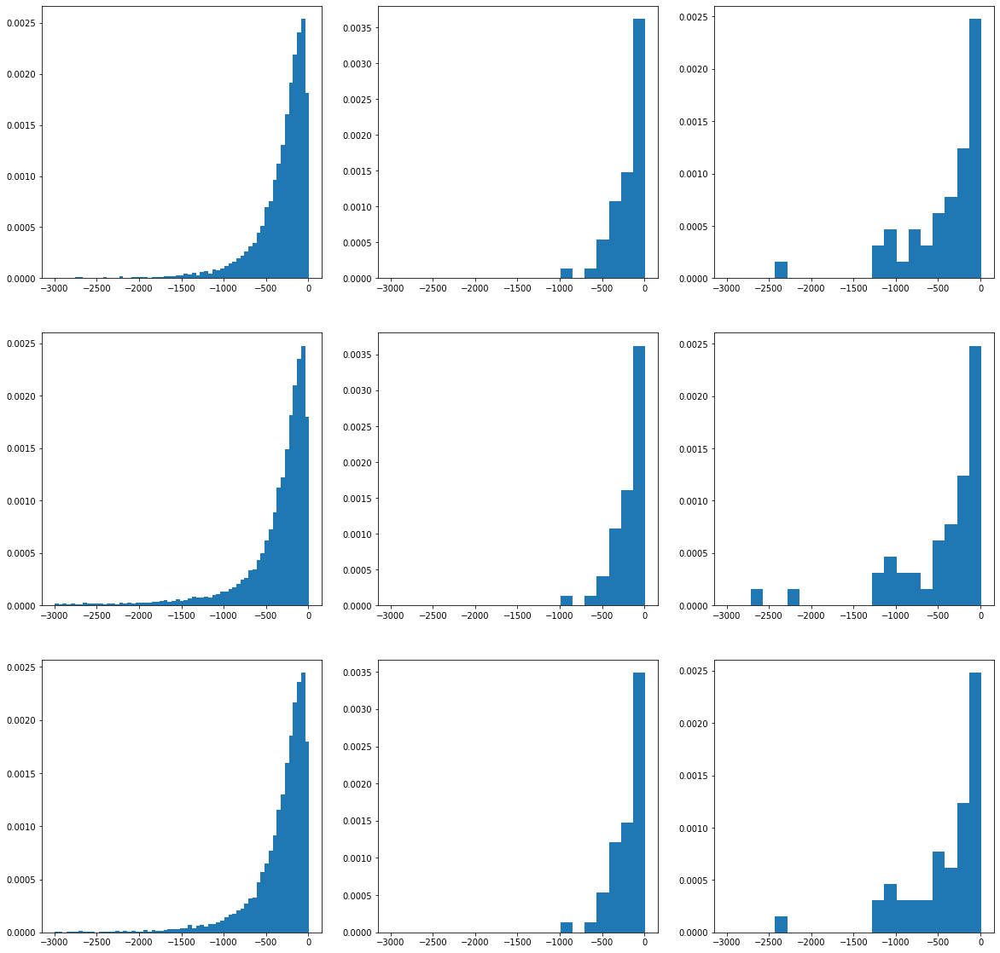

In [169]:
likehood_statistic(likehoods)

### Попробуем разбить цены на интервалы 
* до 10 рублей
* от 10 до 100
* от 100 до 1000
* от 1000 до 5000
* от 5000 до 10000
* от 10000 до 30000
* от 30000 до 50000
* от 50000

In [72]:
cat = [10,100,1000,5000,10000,30000,50000]
genue_amounts_cat = np.searchsorted(cat, genue_amounts)
fraud_amounts_cat = np.searchsorted(cat, fraud_amounts)
rec_fraud_amounts_cat = np.searchsorted(cat, rec_fraud_amounts)

In [73]:
genue_cat_hmm = hmm.MultinomialHMM(n_components=20, n_iter=100)
genue_cat_hmm.fit(genue_amounts_cat, genue_lenghts)

fraud_cat_hmm = hmm.MultinomialHMM(n_components=20, n_iter=100)
fraud_cat_hmm.fit(fraud_amounts_cat, fraud_lenghts)

rec_fraud_cat_hmm = hmm.MultinomialHMM(n_components=20, n_iter=100)
rec_fraud_cat_hmm.fit(rec_fraud_amounts_cat, rec_fraud_lenghts)

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T


MultinomialHMM(algorithm='viterbi', init_params='ste', n_components=20,
               n_iter=100, params='ste',
               random_state=RandomState(MT19937) at 0x10BBAE6B0,
               startprob_prior=1.0, tol=0.01, transmat_prior=1.0,
               verbose=False)

In [42]:
likehoods_cat = []
for hmm in [genue_cat_hmm, fraud_cat_hmm, rec_fraud_cat_hmm]:
    likehood = []
    for sample in zip([genue_amounts_cat,fraud_amounts_cat,rec_fraud_amounts_cat],[genue_lenghts,fraud_lenghts,rec_fraud_lenghts]):
        likehood_s = []
        cum = 0
        for l in sample[1]:
            likehood_s.append(hmm.score(sample[0][cum:cum+l]))
            cum+=l
        likehood.append(likehood_s)
    likehoods_cat.append(likehood)

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

-63.33872081936553 104.78667061420016
-40.94990727542823 40.175229435255666
-100.85592937015349 146.4037320382544
---------
-81.78631429241703 127.16745953395687
-29.9251885252883 31.553587571151922
-124.86325924740375 179.0850553761609
---------
-80.60989507260214 111.02471432176884
-50.32844581072063 52.72985538865337
-67.53578008210619 91.10990326422387
---------


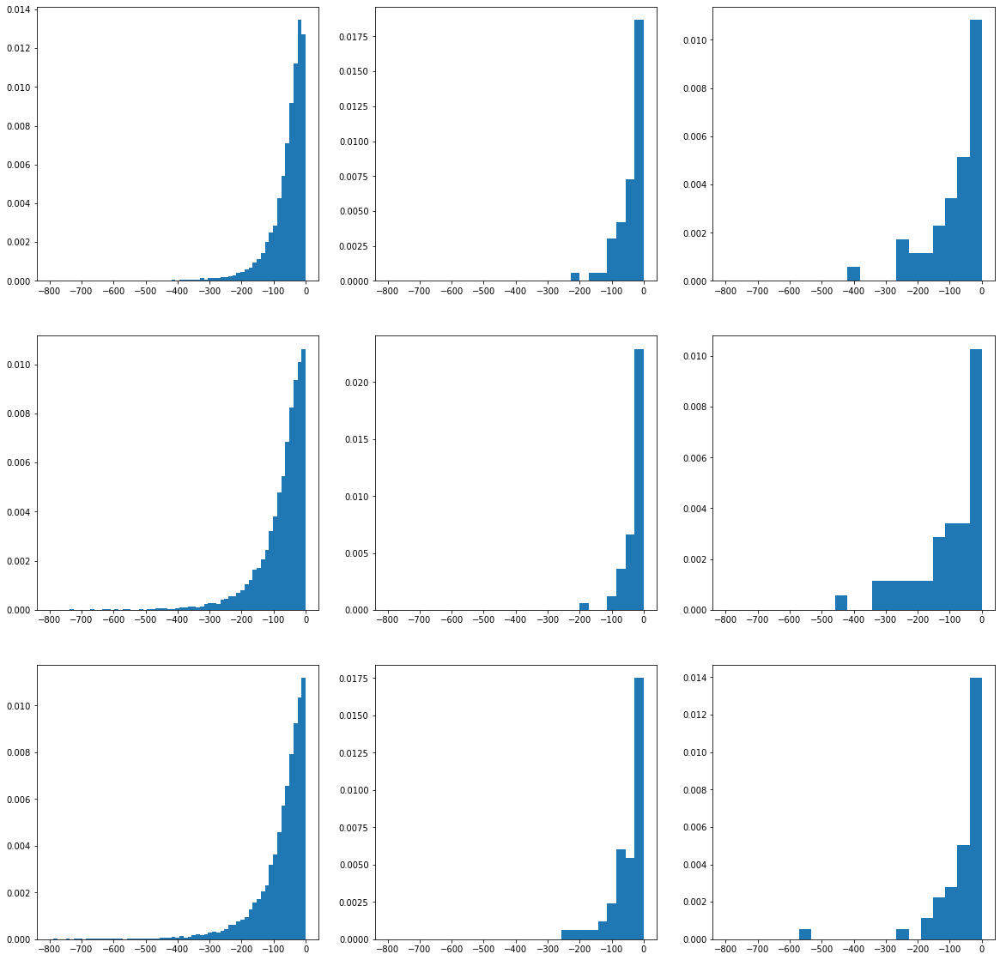

In [45]:
likehood_statistic(likehoods_cat, range_ = (-800,0))

In [163]:
likehoods_cat = []
for hmm in [genue_cat_hmm, fraud_cat_hmm, rec_fraud_cat_hmm]:
    likehood = []
    for sample in zip([genue_amounts_cat,fraud_amounts_cat,rec_fraud_amounts_cat],[genue_lenghts,fraud_lenghts,rec_fraud_lenghts]):
        likehood_s = []
        cum = 0
        for l in sample[1]:
            likehood_s.append(hmm.score(sample[0][cum:cum+l]))
            cum+=l
        likehood.append(likehood_s)
    likehoods_cat.append(likehood)

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

-59.71176975954415 82.7434573670161
-36.78118560210077 33.24300296849726
-88.57124871700955 114.84938926796977
---------
-65.95672473871919 104.55081921219193
-34.52077818699946 31.523363855366174
-101.36568956911286 150.30316453901622
---------
-64.94826382744259 91.2833360545626
-39.25432064198553 36.53690243297976
-83.33950018276641 106.70007209726637
---------


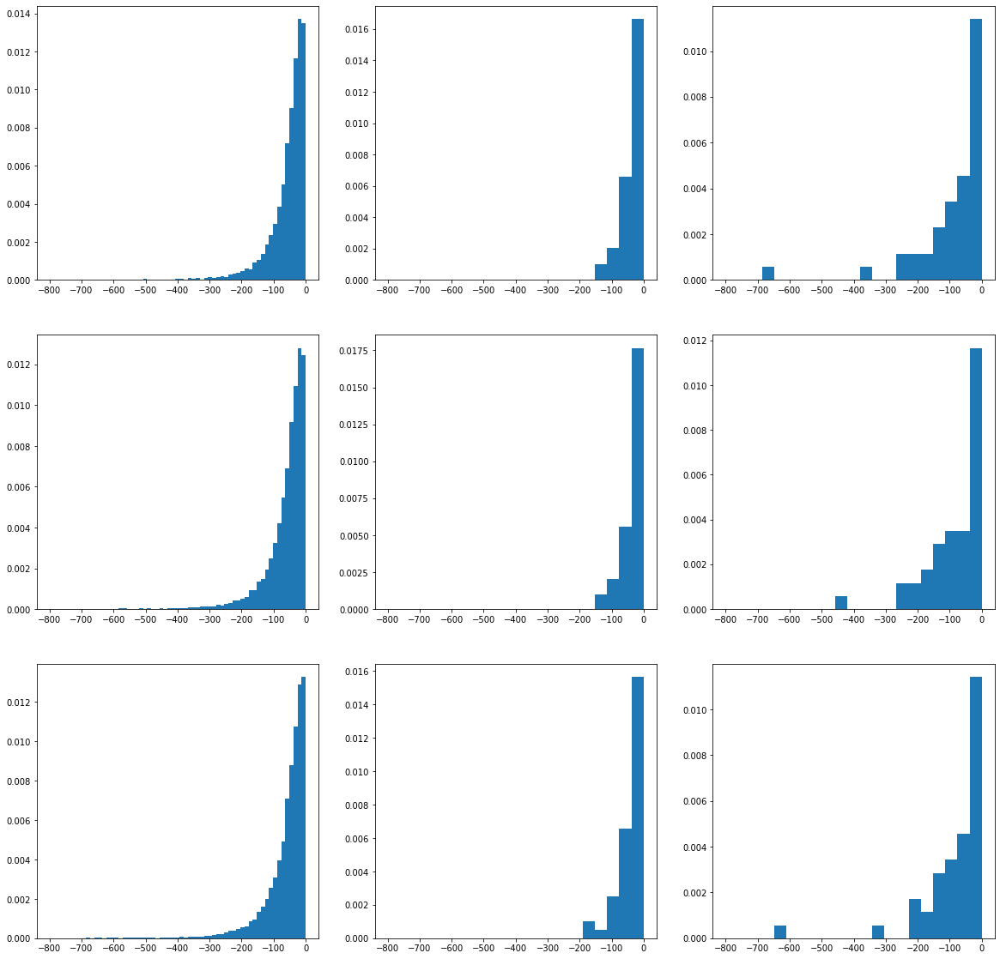

In [174]:
likehood_statistic(likehoods_cat, range_ = (-800,0))

### Считаем теперь для разницы во времени между транзакциями

(array([1.25458248e-03, 2.68839104e-04, 1.34419552e-04, 1.14052953e-04,
        1.01832994e-04, 7.33197556e-05, 8.55397149e-05, 1.30346232e-04,
        8.14663951e-05, 6.10997963e-05, 6.92464358e-05, 6.51731161e-05,
        3.66598778e-05, 4.07331976e-05, 4.48065173e-05, 4.48065173e-05,
        3.66598778e-05, 4.88798371e-05, 4.88798371e-05, 1.22199593e-05,
        4.48065173e-05, 3.25865580e-05, 5.29531568e-05, 4.48065173e-05,
        1.62932790e-05, 2.44399185e-05, 2.44399185e-05, 4.48065173e-05,
        3.25865580e-05, 2.03665988e-05, 1.22199593e-05, 2.85132383e-05,
        2.85132383e-05, 2.03665988e-05, 3.25865580e-05, 1.62932790e-05,
        3.25865580e-05, 2.03665988e-05, 4.07331976e-06, 2.03665988e-05,
        1.22199593e-05, 8.14663951e-06, 3.25865580e-05, 2.85132383e-05,
        1.22199593e-05, 3.25865580e-05, 1.62932790e-05, 4.07331976e-06,
        1.22199593e-05, 2.85132383e-05, 1.62932790e-05, 2.44399185e-05,
        8.14663951e-06, 2.03665988e-05, 0.00000000e+00, 1.629327

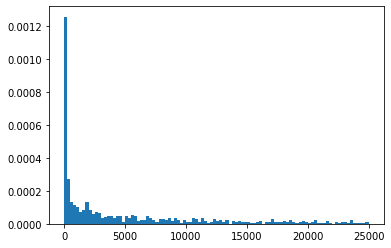

In [82]:
plt.hist(np.array(t_delta_fraud).ravel(), bins = 100, range=(0,25000), density=True)

(array([1.39212004e-03, 2.91959336e-04, 1.91175674e-04, 1.47171413e-04,
        1.18876510e-04, 1.02869215e-04, 8.80807497e-05, 8.23928784e-05,
        7.03580650e-05, 6.63855835e-05, 6.11581589e-05, 5.52897203e-05,
        5.06581680e-05, 4.68211119e-05, 4.63155234e-05, 4.26680631e-05,
        4.04922266e-05, 3.93365956e-05, 3.60683267e-05, 3.48043553e-05,
        3.28813131e-05, 3.19694480e-05, 3.09131291e-05, 2.85206118e-05,
        2.72566404e-05, 2.73920659e-05, 2.59384988e-05, 2.55863924e-05,
        2.43224210e-05, 2.34286127e-05, 2.24264639e-05, 2.25799462e-05,
        2.12618046e-05, 2.08013579e-05, 1.95644716e-05, 1.93207057e-05,
        1.78039400e-05, 1.82463300e-05, 1.73886351e-05, 1.69101316e-05,
        1.69913869e-05, 1.63232878e-05, 1.57906141e-05, 1.60704935e-05,
        1.46981817e-05, 1.40120258e-05, 1.36508911e-05, 1.34342103e-05,
        1.34793521e-05, 1.38134017e-05, 1.31453025e-05, 1.23959481e-05,
        1.26306856e-05, 1.10326646e-05, 1.06895867e-05, 1.112294

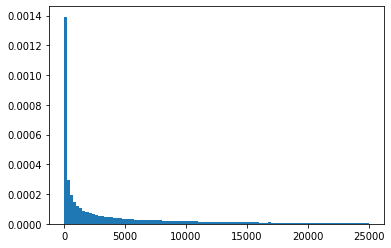

In [78]:
plt.hist(np.array(t_delta_genue).ravel(), bins = 100, range=(0,25000),density=True)

(array([2.07213115e-03, 3.32786885e-04, 1.77049180e-04, 1.04918033e-04,
        9.18032787e-05, 7.54098361e-05, 6.06557377e-05, 5.08196721e-05,
        5.90163934e-05, 3.44262295e-05, 4.26229508e-05, 5.24590164e-05,
        4.75409836e-05, 3.77049180e-05, 4.09836066e-05, 2.62295082e-05,
        1.63934426e-05, 3.44262295e-05, 3.27868852e-05, 2.45901639e-05,
        1.80327869e-05, 1.31147541e-05, 1.63934426e-05, 2.95081967e-05,
        1.80327869e-05, 1.47540984e-05, 4.91803279e-06, 1.80327869e-05,
        1.31147541e-05, 2.13114754e-05, 1.31147541e-05, 6.55737705e-06,
        1.96721311e-05, 6.55737705e-06, 1.31147541e-05, 1.14754098e-05,
        8.19672131e-06, 8.19672131e-06, 9.83606557e-06, 8.19672131e-06,
        1.14754098e-05, 4.91803279e-06, 6.55737705e-06, 6.55737705e-06,
        8.19672131e-06, 8.19672131e-06, 1.14754098e-05, 1.63934426e-06,
        6.55737705e-06, 1.14754098e-05, 1.47540984e-05, 6.55737705e-06,
        1.63934426e-06, 1.31147541e-05, 0.00000000e+00, 8.196721

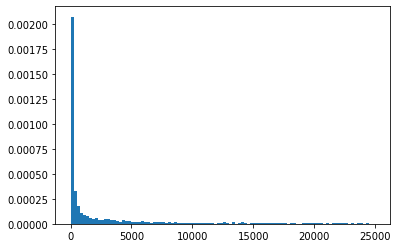

In [81]:
plt.hist(np.array(t_delta_rec_fraud).ravel(), bins = 100, range=(0,25000), density=True)

### Разбиваем на следующие категории:
* менее минуты
* менее 5 мин
* менее 10 мин
* 30
* 60
* 3 часа 
* 5
* 12
* 24
* 2 дня 
* неделя
* больше недели

In [93]:
time_cat = [60, 300, 600, 1800, 3600, 10800, 18000, 3600*12, 3600*24, 3600*48, 3600*24*7]
genue_times_cat = np.searchsorted(time_cat, t_delta_genue)
fraud_times_cat = np.searchsorted(time_cat, t_delta_fraud)
rec_fraud_times_cat = np.searchsorted(time_cat, t_delta_rec_fraud)


In [94]:
rec_fraud_times_cat = np.append(rec_fraud_times_cat, 11).reshape((-1,1))
fraud_times_cat = np.append(fraud_times_cat, 11).reshape((-1,1))

In [76]:
genue_time_hmm = hmm.MultinomialHMM(n_components=10, n_iter=100)
genue_time_hmm.fit(genue_times_cat, genue_lenghts[genue_lenghts-1!=0]-1)

fraud_time_hmm = hmm.MultinomialHMM(n_components=10, n_iter=100)
fraud_time_hmm.fit(fraud_times_cat, np.append(fraud_lenghts[fraud_lenghts-1!=0], 2)-1)

rec_fraud_time_hmm = hmm.MultinomialHMM(n_components=10, n_iter=100)
rec_fraud_time_hmm.fit(rec_fraud_times_cat, np.append(rec_fraud_lenghts[rec_fraud_lenghts-1!=0], 2)-1)

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T


MultinomialHMM(algorithm='viterbi', init_params='ste', n_components=10,
               n_iter=100, params='ste',
               random_state=RandomState(MT19937) at 0x10BBAE6B0,
               startprob_prior=1.0, tol=0.01, transmat_prior=1.0,
               verbose=False)

In [173]:
likehoods_cat = []
for hmm in [genue_time_hmm, fraud_time_hmm, rec_fraud_time_hmm]:
    likehood = []
    for sample in zip([genue_times_cat,fraud_times_cat,rec_fraud_times_cat],[genue_lenghts[genue_lenghts-1!=0]-1,
                                                                             fraud_lenghts[fraud_lenghts-1!=0]-1,
                                                                             np.append(rec_fraud_lenghts[rec_fraud_lenghts-1!=0], 2)-1]):
        likehood_s = []
        cum = 0
        for l in sample[1]:
            likehood_s.append(hmm.score(sample[0][cum:cum+l]))
            cum+=l
        likehood.append(likehood_s)
    likehoods_cat.append(likehood)

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

-79.56666191572772 98.62068455034401
-52.55753705621305 45.057850316605965
-107.42074332719854 139.1695562587057
---------
-84.96145058994985 129.80399175631763
-50.32077568029269 44.03477638995643
-122.79800605385454 190.85176346275523
---------
-82.58931229630113 102.61386404827917
-54.82502508557098 46.735775436291
-103.15875612593972 127.37153067147467
---------


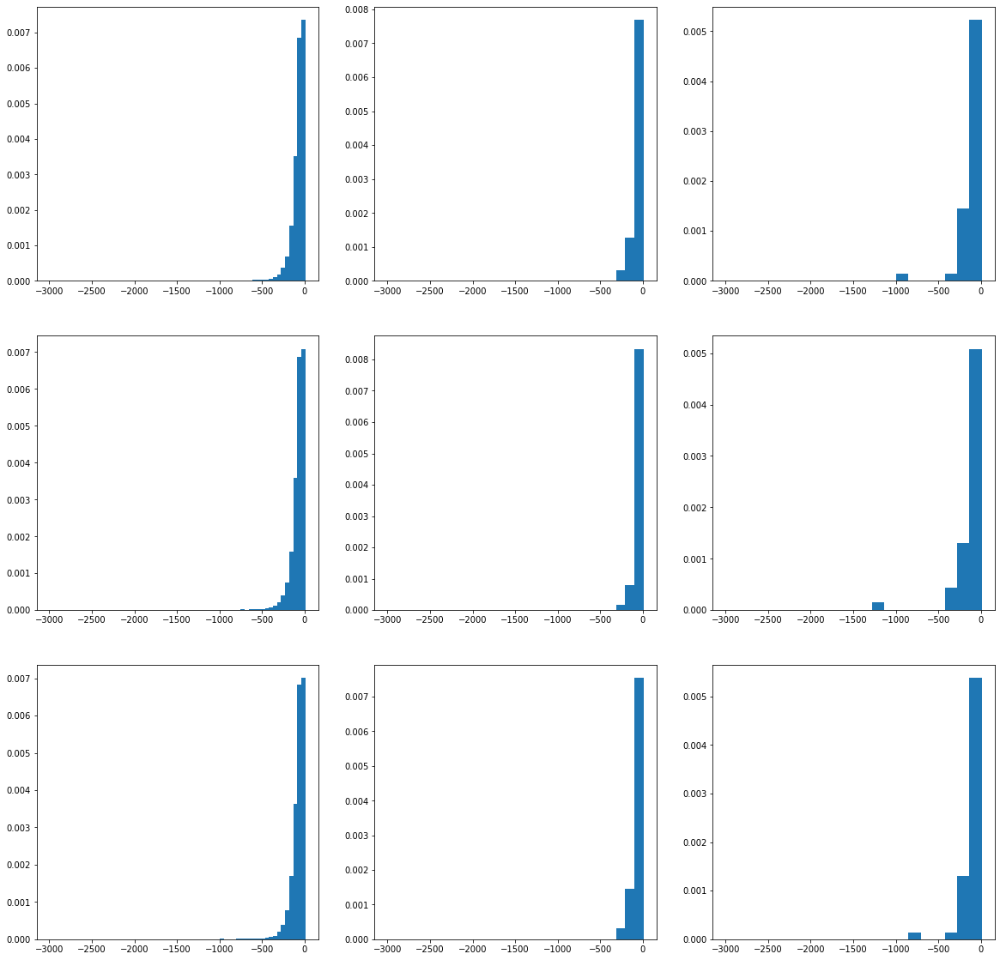

In [174]:
likehood_statistic(likehoods_cat)

### Видно что для 100 компонент есть различия для цепочек транзакций разных типов. Считаем правдоподобия для клиентов из размеченной выборки
### Для времени тоже надо сделать больше компонент, но попозже

In [96]:
hmm_features = []

for us1, us2, dt in tr_tst[['user_id', 'rec_user_id', 'date_time']].values:
    hmm_feat = []
    trans1 = transactions[(transactions.user_id==us1)&(transactions.date_time<dt)].sort_values(by = 'date_time',ascending= False)[['date_time','amount']]
    trans2 = transactions[(transactions.user_id==us2)&(transactions.date_time<dt)].sort_values(by = 'date_time', ascending= False)[['date_time','amount']]
    
    time1 = []
    time2 = []
    for i in range(len(trans1)-1):
        time1.append(sec_diff(trans1.date_time.iloc[i], trans1.date_time.iloc[i+1]))
        
    for i in range(len(trans2)-1):
        time2.append(sec_diff(trans2.date_time.iloc[i], trans2.date_time.iloc[i+1]))

    amount1 = np.searchsorted(cat, trans1.amount.values).reshape((-1,1))
    amount2 = np.searchsorted(cat, trans2.amount.values).reshape((-1,1))
    
    time1 = np.searchsorted(time_cat, time1).reshape((-1,1))
    time2 = np.searchsorted(time_cat, time2).reshape((-1,1))
    
    for t in [time1, time2]:
        for hmm in [genue_time_hmm, fraud_time_hmm, rec_fraud_time_hmm]:
            if len(t):
                hmm_feat.append(hmm.score(t))
            else:
                hmm_feat.append(1)
            
    for amt in [amount1, amount2]:
        for hmm in [genue_cat_hmm, fraud_cat_hmm, rec_fraud_cat_hmm]:
            hmm_feat.append(hmm.score(amt))
            
    hmm_features.append(hmm_feat)

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/hmmlearn/hmm.py:412: RuntimeWarning: divide by zero encountered in log
  return np.log(self.emissionprob_)[:, np.concatenate(X)].T
/Users/val

In [97]:
np.save('hmm_features',np.array(hmm_features))

In [98]:
hmm_features = pd.DataFrame(np.array(hmm_features))

In [99]:
hmm_features.index = tr_tst.index
time_features.index = tr_tst.index


In [100]:
paras_fetures = np.zeros((tr_tst.shape[0], 4), dtype=np.float128)
for user in enumerate(tr_tst[['user_id', 'rec_user_id']].values):
    i = user[0]
    dt1 = calculate_hours(transactions[transactions.user_id == user[1][0]].date_time)
    dt2 = calculate_hours(transactions[transactions.user_id == user[1][1]].date_time)
    mean1 = calculate_periodic_mean(dt1)
    std1 = calculate_periodic_std(dt1)
    mean2 = calculate_periodic_mean(dt2)
    std2 = calculate_periodic_std(dt2)
    paras_fetures[i][0] = mean1
    paras_fetures[i][1] = std1
    paras_fetures[i][2] = mean2
    paras_fetures[i][3] = std2

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: invalid value encountered in sqrt
  """


In [101]:
for i in range(len(paras_fetures)):
    for j in range(4):
        if paras_fetures[i][j]<0:
            paras_fetures[i][j]+=2*np.pi

In [105]:
params_fetures = pd.DataFrame(paras_fetures)
params_fetures.index = tr_tst.index

ValueError: Length mismatch: Expected axis has 8169 elements, new values have 4085 elements

In [195]:
hmm_and_time = pd.concat([params_fetures, time_features, hmm_features],axis =1)

In [196]:
pd.DataFrame.to_csv(hmm_and_time, 'features.csv')

### Обучение модели

In [115]:
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import GridSearchCV , cross_val_score
from sklearn import metrics

In [116]:
enc = OneHotEncoder(sparse=False)
sub_chan = enc.fit_transform(tr_tst.sub_channel.values.reshape((-1,1)))

In [121]:
sub_chan = pd.DataFrame(sub_chan)
sub_chan.index = tr_tst.index

In [124]:
hmm_and_time = pd.concat([hmm_and_time, sub_chan], axis =1)

In [125]:
hmm_and_time.isna()

,0,1,2,3,0,1,2,3,4,5,...,5,6,7,8,9,10,11,0,1,2
8896,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
3728,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
3117,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
5678,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
1582,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8548,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
6154,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
7397,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
634,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False


In [126]:
hmm_and_time.columns = list(range(83))
hmm_and_time.isna().sum()[hmm_and_time.isna().sum()>0]

1    4
3    4
dtype: int64

In [127]:
hmm_and_time[[1,3]][tr_tst.resolution!='G'].isna().sum()

1    0
3    0
dtype: int64

In [128]:
hmm_and_time = hmm_and_time.fillna(0)

In [129]:
from sklearn.ensemble import RandomForestClassifier
import catboost
from sklearn.metrics import precision_recall_curve
import imblearn

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/Users/valerka_bvv/anaconda2/envs/

In [130]:
r_f = RandomForestClassifier().fit(hmm_and_time, target_tst)

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/sklearn/ensemble/forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


In [131]:
pr, recall, thrh = precision_recall_curve(target_tst, r_f.predict_proba(hmm_and_time)[:,1])

In [132]:
recall

array([1.     , 0.96875, 0.96875, 0.90625, 0.71875, 0.5    , 0.3125 ,
       0.21875, 0.     ])

In [133]:
pr

array([0.86486486, 0.96875   , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        ])

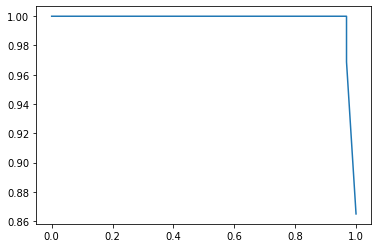

In [134]:
plt.plot(recall, pr)

In [135]:
cross_val_score(RandomForestClassifier(),hmm_and_time, target_tst, scoring=metrics.make_scorer(metrics.recall_score))

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/sklearn/model_selection/_split.py:1978: FutureWarning: The default value of cv will change from 3 to 5 in version 0.22. Specify it explicitly to silence this warning.
  warnings.warn(CV_WARNING, FutureWarning)
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/sklearn/ensemble/forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/sklearn/ensemble/forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/sklearn/ensemble/forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in vers

array([0.09090909, 0.        , 0.1       ])

In [136]:
cross_val_score(RandomForestClassifier(),hmm_and_time, target_tst, scoring=metrics.make_scorer(metrics.precision_score))

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/sklearn/model_selection/_split.py:1978: FutureWarning: The default value of cv will change from 3 to 5 in version 0.22. Specify it explicitly to silence this warning.
  warnings.warn(CV_WARNING, FutureWarning)
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/sklearn/ensemble/forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/sklearn/ensemble/forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples.
  'prec

array([1., 0., 1.])

In [137]:
X_und, y_und = imblearn.under_sampling.RandomUnderSampler(sampling_strategy=0.01).fit_resample(hmm_and_time, target_tst)

In [138]:
X_os, y_os = imblearn.over_sampling.ADASYN(sampling_strategy=0.2).fit_resample(X_und, y_und)

In [139]:
cross_val_score(RandomForestClassifier(), X_os, y_os, scoring=metrics.make_scorer(metrics.recall_score))

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/sklearn/model_selection/_split.py:1978: FutureWarning: The default value of cv will change from 3 to 5 in version 0.22. Specify it explicitly to silence this warning.
  warnings.warn(CV_WARNING, FutureWarning)
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/sklearn/ensemble/forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/sklearn/ensemble/forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/sklearn/ensemble/forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in vers

array([0.73933649, 0.86255924, 0.82857143])

In [140]:
cross_val_score(RandomForestClassifier(),X_os, y_os, scoring=metrics.make_scorer(metrics.precision_score))

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/sklearn/model_selection/_split.py:1978: FutureWarning: The default value of cv will change from 3 to 5 in version 0.22. Specify it explicitly to silence this warning.
  warnings.warn(CV_WARNING, FutureWarning)
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/sklearn/ensemble/forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/sklearn/ensemble/forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/sklearn/ensemble/forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in vers

array([1.       , 0.9939759, 1.       ])

In [141]:
r_f_model = RandomForestClassifier().fit(X_os, y_os)

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/sklearn/ensemble/forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


In [155]:
r_f_model.predict_proba(hmm_and_time)[:,1]

array([0., 0., 0., ..., 0., 0., 0.])

In [142]:
( (r_f_model.predict(hmm_and_time)==1)&(target_tst==1)).sum()

29

In [144]:
pr, rc= metrics.precision_recall_curve(target_tst,r_f_model.predict_proba(hmm_and_time)[:,1])[:2]

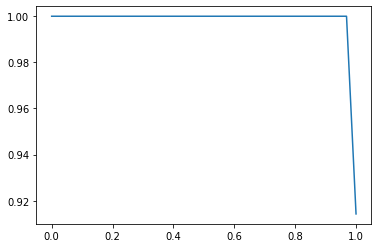

In [145]:
plt.plot(rc, pr)

In [147]:
metrics.precision_recall_curve(target_tst,r_f_model.predict_proba(hmm_and_time)[:,1])

(array([0.91428571, 1.        , 1.        , 1.        , 1.        ,
        1.        , 1.        ]),
 array([1.     , 0.96875, 0.90625, 0.84375, 0.46875, 0.28125, 0.     ]),
 array([0.4, 0.5, 0.7, 0.8, 0.9, 1. ]))

In [154]:
hmm_and_time.corr()

,0,1,2,3,4,5,6,7,8,9,...,73,74,75,76,77,78,79,80,81,82
0,1.000000,-0.116642,0.298645,-0.055704,-0.062310,-0.055897,-0.088291,-0.062083,-0.079121,-0.063331,...,0.184266,0.080926,0.068480,0.073188,0.182632,0.178552,0.181872,0.131685,-0.145238,0.046978
1,-0.116642,1.000000,-0.071500,0.079212,0.314375,0.407785,0.152395,0.301843,-0.004520,0.161965,...,-0.135373,-0.205948,-0.166163,-0.196483,-0.129423,-0.125443,-0.129469,-0.176932,0.195501,-0.063729
2,0.298645,-0.071500,1.000000,-0.125038,-0.023409,-0.021094,-0.021865,-0.025119,-0.015006,-0.011770,...,0.210511,0.048313,0.044741,0.042641,0.188606,0.180318,0.190325,0.074176,-0.070467,0.007227
3,-0.055704,0.079212,-0.125038,1.000000,0.020075,0.038042,0.022598,0.032727,0.023602,0.031032,...,-0.222810,-0.034316,-0.030079,-0.023966,-0.189401,-0.173726,-0.184108,-0.056883,0.043931,0.011597
4,-0.062310,0.314375,-0.023409,0.020075,1.000000,0.792759,0.749317,0.723302,0.517894,0.604788,...,-0.043151,-0.150908,-0.122620,-0.152242,-0.042038,-0.039764,-0.044094,-0.064551,0.082364,-0.041967
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
78,0.178552,-0.125443,0.180318,-0.173726,-0.039764,-0.070993,-0.006765,-0.050675,-0.010297,-0.039062,...,0.979190,-0.002101,-0.012942,-0.021168,0.998353,1.000000,0.995897,0.129769,-0.119917,0.006940
79,0.181872,-0.129469,0.190325,-0.184108,-0.044094,-0.074698,-0.009975,-0.053731,-0.012373,-0.041279,...,0.979963,0.003019,-0.008000,-0.015712,0.997667,0.995897,1.000000,0.134508,-0.124032,0.006746
80,0.131685,-0.176932,0.074176,-0.056883,-0.064551,-0.112098,-0.052985,-0.098041,-0.013538,-0.061080,...,0.129517,0.090595,0.074951,0.090913,0.132098,0.129769,0.134508,1.000000,-0.811645,-0.137172
81,-0.145238,0.195501,-0.070467,0.043931,0.082364,0.129148,0.059026,0.108009,0.022907,0.076203,...,-0.122505,-0.095509,-0.074738,-0.095234,-0.122519,-0.119917,-0.124032,-0.811645,1.000000,-0.467295


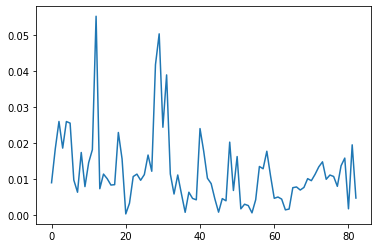

In [152]:
plt.plot(r_f_model.feature_importances_)

In [153]:
r_f_model.feature_importances_

array([0.00891529, 0.01831073, 0.02596802, 0.01855363, 0.02594731,
       0.02550561, 0.0096555 , 0.0062743 , 0.01733414, 0.00783912,
       0.01451033, 0.01811705, 0.0552507 , 0.00725352, 0.01132362,
       0.01003265, 0.00827535, 0.00837768, 0.02290228, 0.01554464,
       0.00023986, 0.00322218, 0.01063865, 0.0113154 , 0.00960118,
       0.01118722, 0.01662528, 0.01211095, 0.04176507, 0.05035202,
       0.02436009, 0.03892668, 0.01136024, 0.00578046, 0.01107097,
       0.00579769, 0.00068637, 0.0062756 , 0.00454522, 0.0041668 ,
       0.02398897, 0.01765143, 0.0101724 , 0.00867467, 0.00442277,
       0.00073072, 0.00449779, 0.00389355, 0.02022018, 0.00676284,
       0.01620353, 0.00165418, 0.00293833, 0.00256379, 0.00053584,
       0.00418352, 0.01344072, 0.01280712, 0.0176804 , 0.01084156,
       0.00458425, 0.00494114, 0.00436241, 0.00136666, 0.00159712,
       0.00753895, 0.00774228, 0.00688752, 0.00760886, 0.0100536 ,
       0.00949045, 0.01125666, 0.01333721, 0.01473685, 0.00987

In [161]:
r_f_model.predict_proba(hmm_and_time[target_tst==1])[:,1]

array([0.8, 0.8, 0.5, 0.9, 0.9, 0.8, 1. , 1. , 0.9, 1. , 0.9, 0.9, 0.9,
       0.8, 0.7, 0.8, 0.4, 1. , 0.8, 0.8, 1. , 1. , 1. , 0.8, 0.8, 0.8,
       1. , 0.5, 1. , 0.7, 0.8, 0.8])

In [160]:
r_f.predict_proba(hmm_and_time[target_tst==1])[:,1]

array([0.4, 0.6, 0.5, 0.4, 0.5, 0.7, 0.5, 0.8, 0.7, 0.9, 0.7, 0.2, 0.7,
       0.7, 0.5, 0.6, 0.5, 0.6, 0.8, 0.7, 0.9, 0.9, 0.9, 0.6, 0.5, 0.9,
       0.6, 0.6, 0.9, 0.6, 0.8, 0.9])

In [162]:
cross_val_score(catboost.CatBoostClassifier(),X_os, y_os, scoring=metrics.make_scorer(metrics.precision_score))

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/sklearn/model_selection/_split.py:1978: FutureWarning: The default value of cv will change from 3 to 5 in version 0.22. Specify it explicitly to silence this warning.
  warnings.warn(CV_WARNING, FutureWarning)


Learning rate set to 0.021846
0:	learn: 0.6674156	total: 102ms	remaining: 1m 42s
1:	learn: 0.6436641	total: 120ms	remaining: 59.7s
2:	learn: 0.6172344	total: 129ms	remaining: 43s
3:	learn: 0.5943770	total: 138ms	remaining: 34.4s
4:	learn: 0.5732024	total: 147ms	remaining: 29.3s
5:	learn: 0.5518841	total: 156ms	remaining: 25.8s
6:	learn: 0.5319421	total: 165ms	remaining: 23.4s
7:	learn: 0.5148722	total: 175ms	remaining: 21.8s
8:	learn: 0.4958215	total: 184ms	remaining: 20.3s
9:	learn: 0.4768181	total: 201ms	remaining: 19.9s
10:	learn: 0.4615656	total: 212ms	remaining: 19.1s
11:	learn: 0.4467256	total: 222ms	remaining: 18.3s
12:	learn: 0.4342881	total: 231ms	remaining: 17.5s
13:	learn: 0.4183373	total: 240ms	remaining: 16.9s
14:	learn: 0.4038496	total: 248ms	remaining: 16.3s
15:	learn: 0.3932774	total: 257ms	remaining: 15.8s
16:	learn: 0.3796467	total: 266ms	remaining: 15.4s
17:	learn: 0.3690246	total: 275ms	remaining: 15s
18:	learn: 0.3595697	total: 284ms	remaining: 14.7s
19:	learn: 0.3

166:	learn: 0.0382225	total: 1.84s	remaining: 9.19s
167:	learn: 0.0379587	total: 1.85s	remaining: 9.18s
168:	learn: 0.0376701	total: 1.86s	remaining: 9.15s
169:	learn: 0.0374155	total: 1.87s	remaining: 9.13s
170:	learn: 0.0371624	total: 1.88s	remaining: 9.11s
171:	learn: 0.0368295	total: 1.89s	remaining: 9.09s
172:	learn: 0.0365656	total: 1.9s	remaining: 9.06s
173:	learn: 0.0361996	total: 1.9s	remaining: 9.04s
174:	learn: 0.0359466	total: 1.91s	remaining: 9.01s
175:	learn: 0.0356179	total: 1.92s	remaining: 8.99s
176:	learn: 0.0352695	total: 1.93s	remaining: 8.96s
177:	learn: 0.0351186	total: 1.94s	remaining: 8.94s
178:	learn: 0.0348233	total: 1.94s	remaining: 8.92s
179:	learn: 0.0345373	total: 1.95s	remaining: 8.89s
180:	learn: 0.0342668	total: 1.96s	remaining: 8.87s
181:	learn: 0.0339129	total: 1.97s	remaining: 8.85s
182:	learn: 0.0336291	total: 1.98s	remaining: 8.82s
183:	learn: 0.0333072	total: 1.99s	remaining: 8.8s
184:	learn: 0.0329629	total: 1.99s	remaining: 8.78s
185:	learn: 0.0

334:	learn: 0.0120997	total: 3.27s	remaining: 6.5s
335:	learn: 0.0120477	total: 3.29s	remaining: 6.5s
336:	learn: 0.0119934	total: 3.3s	remaining: 6.49s
337:	learn: 0.0119436	total: 3.31s	remaining: 6.48s
338:	learn: 0.0119090	total: 3.32s	remaining: 6.47s
339:	learn: 0.0118069	total: 3.33s	remaining: 6.46s
340:	learn: 0.0117168	total: 3.33s	remaining: 6.44s
341:	learn: 0.0116285	total: 3.34s	remaining: 6.43s
342:	learn: 0.0115627	total: 3.35s	remaining: 6.42s
343:	learn: 0.0115057	total: 3.36s	remaining: 6.41s
344:	learn: 0.0114408	total: 3.37s	remaining: 6.4s
345:	learn: 0.0113203	total: 3.38s	remaining: 6.38s
346:	learn: 0.0112555	total: 3.39s	remaining: 6.37s
347:	learn: 0.0112003	total: 3.4s	remaining: 6.36s
348:	learn: 0.0111496	total: 3.4s	remaining: 6.35s
349:	learn: 0.0110909	total: 3.41s	remaining: 6.34s
350:	learn: 0.0110074	total: 3.42s	remaining: 6.32s
351:	learn: 0.0109507	total: 3.43s	remaining: 6.31s
352:	learn: 0.0109015	total: 3.45s	remaining: 6.32s
353:	learn: 0.0108

508:	learn: 0.0049406	total: 5.36s	remaining: 5.17s
509:	learn: 0.0049130	total: 5.38s	remaining: 5.17s
510:	learn: 0.0048961	total: 5.39s	remaining: 5.16s
511:	learn: 0.0048738	total: 5.4s	remaining: 5.15s
512:	learn: 0.0048312	total: 5.41s	remaining: 5.14s
513:	learn: 0.0048133	total: 5.42s	remaining: 5.13s
514:	learn: 0.0047944	total: 5.44s	remaining: 5.12s
515:	learn: 0.0047720	total: 5.45s	remaining: 5.11s
516:	learn: 0.0047534	total: 5.46s	remaining: 5.11s
517:	learn: 0.0047366	total: 5.48s	remaining: 5.1s
518:	learn: 0.0047194	total: 5.5s	remaining: 5.09s
519:	learn: 0.0046938	total: 5.51s	remaining: 5.09s
520:	learn: 0.0046868	total: 5.52s	remaining: 5.08s
521:	learn: 0.0046676	total: 5.54s	remaining: 5.07s
522:	learn: 0.0046514	total: 5.55s	remaining: 5.06s
523:	learn: 0.0046356	total: 5.56s	remaining: 5.05s
524:	learn: 0.0046110	total: 5.58s	remaining: 5.05s
525:	learn: 0.0046069	total: 5.59s	remaining: 5.04s
526:	learn: 0.0045897	total: 5.61s	remaining: 5.03s
527:	learn: 0.0

679:	learn: 0.0028217	total: 6.99s	remaining: 3.29s
680:	learn: 0.0028122	total: 7.01s	remaining: 3.28s
681:	learn: 0.0028018	total: 7.02s	remaining: 3.27s
682:	learn: 0.0027921	total: 7.02s	remaining: 3.26s
683:	learn: 0.0027836	total: 7.03s	remaining: 3.25s
684:	learn: 0.0027756	total: 7.04s	remaining: 3.24s
685:	learn: 0.0027681	total: 7.05s	remaining: 3.23s
686:	learn: 0.0027629	total: 7.06s	remaining: 3.21s
687:	learn: 0.0027596	total: 7.07s	remaining: 3.2s
688:	learn: 0.0027521	total: 7.07s	remaining: 3.19s
689:	learn: 0.0027455	total: 7.08s	remaining: 3.18s
690:	learn: 0.0027412	total: 7.09s	remaining: 3.17s
691:	learn: 0.0027317	total: 7.1s	remaining: 3.16s
692:	learn: 0.0027295	total: 7.11s	remaining: 3.15s
693:	learn: 0.0027220	total: 7.11s	remaining: 3.14s
694:	learn: 0.0027181	total: 7.12s	remaining: 3.13s
695:	learn: 0.0027159	total: 7.13s	remaining: 3.11s
696:	learn: 0.0027060	total: 7.14s	remaining: 3.1s
697:	learn: 0.0027028	total: 7.15s	remaining: 3.09s
698:	learn: 0.0

854:	learn: 0.0019101	total: 8.66s	remaining: 1.47s
855:	learn: 0.0019047	total: 8.68s	remaining: 1.46s
856:	learn: 0.0018961	total: 8.68s	remaining: 1.45s
857:	learn: 0.0018921	total: 8.69s	remaining: 1.44s
858:	learn: 0.0018869	total: 8.7s	remaining: 1.43s
859:	learn: 0.0018837	total: 8.71s	remaining: 1.42s
860:	learn: 0.0018779	total: 8.72s	remaining: 1.41s
861:	learn: 0.0018769	total: 8.73s	remaining: 1.4s
862:	learn: 0.0018738	total: 8.74s	remaining: 1.39s
863:	learn: 0.0018688	total: 8.75s	remaining: 1.38s
864:	learn: 0.0018656	total: 8.76s	remaining: 1.37s
865:	learn: 0.0018611	total: 8.76s	remaining: 1.36s
866:	learn: 0.0018562	total: 8.77s	remaining: 1.35s
867:	learn: 0.0018520	total: 8.79s	remaining: 1.34s
868:	learn: 0.0018479	total: 8.8s	remaining: 1.33s
869:	learn: 0.0018437	total: 8.81s	remaining: 1.32s
870:	learn: 0.0018381	total: 8.82s	remaining: 1.31s
871:	learn: 0.0018339	total: 8.83s	remaining: 1.3s
872:	learn: 0.0018310	total: 8.84s	remaining: 1.29s
873:	learn: 0.00

22:	learn: 0.3347800	total: 201ms	remaining: 8.55s
23:	learn: 0.3268159	total: 214ms	remaining: 8.72s
24:	learn: 0.3193251	total: 223ms	remaining: 8.69s
25:	learn: 0.3117729	total: 231ms	remaining: 8.66s
26:	learn: 0.3035713	total: 240ms	remaining: 8.65s
27:	learn: 0.2951390	total: 248ms	remaining: 8.61s
28:	learn: 0.2866116	total: 256ms	remaining: 8.59s
29:	learn: 0.2799285	total: 264ms	remaining: 8.55s
30:	learn: 0.2738164	total: 273ms	remaining: 8.53s
31:	learn: 0.2672597	total: 282ms	remaining: 8.52s
32:	learn: 0.2604535	total: 290ms	remaining: 8.5s
33:	learn: 0.2550356	total: 299ms	remaining: 8.49s
34:	learn: 0.2503837	total: 307ms	remaining: 8.46s
35:	learn: 0.2455046	total: 316ms	remaining: 8.45s
36:	learn: 0.2397299	total: 324ms	remaining: 8.42s
37:	learn: 0.2338736	total: 332ms	remaining: 8.41s
38:	learn: 0.2291243	total: 340ms	remaining: 8.38s
39:	learn: 0.2248056	total: 349ms	remaining: 8.38s
40:	learn: 0.2201872	total: 357ms	remaining: 8.36s
41:	learn: 0.2153247	total: 366m

185:	learn: 0.0438286	total: 1.84s	remaining: 8.08s
186:	learn: 0.0436002	total: 1.86s	remaining: 8.08s
187:	learn: 0.0432511	total: 1.87s	remaining: 8.06s
188:	learn: 0.0428983	total: 1.88s	remaining: 8.06s
189:	learn: 0.0426860	total: 1.9s	remaining: 8.08s
190:	learn: 0.0424688	total: 1.91s	remaining: 8.11s
191:	learn: 0.0422014	total: 1.93s	remaining: 8.13s
192:	learn: 0.0419594	total: 1.94s	remaining: 8.13s
193:	learn: 0.0416922	total: 1.95s	remaining: 8.11s
194:	learn: 0.0414524	total: 1.96s	remaining: 8.1s
195:	learn: 0.0411557	total: 1.97s	remaining: 8.09s
196:	learn: 0.0408435	total: 1.98s	remaining: 8.07s
197:	learn: 0.0406957	total: 1.99s	remaining: 8.05s
198:	learn: 0.0403765	total: 2s	remaining: 8.04s
199:	learn: 0.0401288	total: 2s	remaining: 8.02s
200:	learn: 0.0399084	total: 2.01s	remaining: 8s
201:	learn: 0.0396040	total: 2.02s	remaining: 7.99s
202:	learn: 0.0392335	total: 2.03s	remaining: 7.97s
203:	learn: 0.0390545	total: 2.04s	remaining: 7.95s
204:	learn: 0.0387777	t

361:	learn: 0.0180852	total: 3.48s	remaining: 6.12s
362:	learn: 0.0180019	total: 3.49s	remaining: 6.12s
363:	learn: 0.0178785	total: 3.5s	remaining: 6.11s
364:	learn: 0.0177791	total: 3.51s	remaining: 6.11s
365:	learn: 0.0176854	total: 3.52s	remaining: 6.1s
366:	learn: 0.0176232	total: 3.53s	remaining: 6.09s
367:	learn: 0.0174977	total: 3.55s	remaining: 6.09s
368:	learn: 0.0174101	total: 3.56s	remaining: 6.08s
369:	learn: 0.0173080	total: 3.57s	remaining: 6.08s
370:	learn: 0.0172500	total: 3.58s	remaining: 6.07s
371:	learn: 0.0171903	total: 3.59s	remaining: 6.07s
372:	learn: 0.0171098	total: 3.6s	remaining: 6.06s
373:	learn: 0.0170368	total: 3.62s	remaining: 6.05s
374:	learn: 0.0169716	total: 3.63s	remaining: 6.05s
375:	learn: 0.0169189	total: 3.64s	remaining: 6.04s
376:	learn: 0.0168061	total: 3.65s	remaining: 6.03s
377:	learn: 0.0167152	total: 3.66s	remaining: 6.03s
378:	learn: 0.0166888	total: 3.68s	remaining: 6.03s
379:	learn: 0.0166055	total: 3.69s	remaining: 6.03s
380:	learn: 0.0

523:	learn: 0.0097576	total: 5.11s	remaining: 4.64s
524:	learn: 0.0096896	total: 5.13s	remaining: 4.64s
525:	learn: 0.0096667	total: 5.14s	remaining: 4.63s
526:	learn: 0.0096416	total: 5.15s	remaining: 4.62s
527:	learn: 0.0096028	total: 5.15s	remaining: 4.61s
528:	learn: 0.0095918	total: 5.16s	remaining: 4.6s
529:	learn: 0.0095552	total: 5.17s	remaining: 4.58s
530:	learn: 0.0095359	total: 5.18s	remaining: 4.57s
531:	learn: 0.0095148	total: 5.19s	remaining: 4.56s
532:	learn: 0.0094639	total: 5.2s	remaining: 4.55s
533:	learn: 0.0094352	total: 5.2s	remaining: 4.54s
534:	learn: 0.0094308	total: 5.21s	remaining: 4.53s
535:	learn: 0.0093965	total: 5.22s	remaining: 4.52s
536:	learn: 0.0093695	total: 5.23s	remaining: 4.51s
537:	learn: 0.0093517	total: 5.24s	remaining: 4.5s
538:	learn: 0.0093469	total: 5.24s	remaining: 4.49s
539:	learn: 0.0093137	total: 5.25s	remaining: 4.47s
540:	learn: 0.0092716	total: 5.26s	remaining: 4.46s
541:	learn: 0.0092650	total: 5.27s	remaining: 4.45s
542:	learn: 0.00

699:	learn: 0.0061929	total: 6.74s	remaining: 2.89s
700:	learn: 0.0061672	total: 6.75s	remaining: 2.88s
701:	learn: 0.0061541	total: 6.76s	remaining: 2.87s
702:	learn: 0.0061513	total: 6.77s	remaining: 2.86s
703:	learn: 0.0061405	total: 6.78s	remaining: 2.85s
704:	learn: 0.0061220	total: 6.79s	remaining: 2.84s
705:	learn: 0.0061168	total: 6.79s	remaining: 2.83s
706:	learn: 0.0061144	total: 6.8s	remaining: 2.82s
707:	learn: 0.0061040	total: 6.81s	remaining: 2.81s
708:	learn: 0.0060850	total: 6.82s	remaining: 2.8s
709:	learn: 0.0060617	total: 6.83s	remaining: 2.79s
710:	learn: 0.0060429	total: 6.83s	remaining: 2.78s
711:	learn: 0.0060339	total: 6.84s	remaining: 2.77s
712:	learn: 0.0060318	total: 6.85s	remaining: 2.76s
713:	learn: 0.0060144	total: 6.86s	remaining: 2.75s
714:	learn: 0.0060108	total: 6.87s	remaining: 2.74s
715:	learn: 0.0060051	total: 6.88s	remaining: 2.73s
716:	learn: 0.0059950	total: 6.88s	remaining: 2.72s
717:	learn: 0.0059806	total: 6.89s	remaining: 2.71s
718:	learn: 0.

880:	learn: 0.0045176	total: 8.36s	remaining: 1.13s
881:	learn: 0.0045066	total: 8.38s	remaining: 1.12s
882:	learn: 0.0044946	total: 8.38s	remaining: 1.11s
883:	learn: 0.0044920	total: 8.39s	remaining: 1.1s
884:	learn: 0.0044896	total: 8.4s	remaining: 1.09s
885:	learn: 0.0044884	total: 8.41s	remaining: 1.08s
886:	learn: 0.0044830	total: 8.41s	remaining: 1.07s
887:	learn: 0.0044695	total: 8.42s	remaining: 1.06s
888:	learn: 0.0044566	total: 8.43s	remaining: 1.05s
889:	learn: 0.0044546	total: 8.44s	remaining: 1.04s
890:	learn: 0.0044526	total: 8.45s	remaining: 1.03s
891:	learn: 0.0044373	total: 8.46s	remaining: 1.02s
892:	learn: 0.0044339	total: 8.46s	remaining: 1.01s
893:	learn: 0.0044221	total: 8.47s	remaining: 1s
894:	learn: 0.0044063	total: 8.48s	remaining: 995ms
895:	learn: 0.0044045	total: 8.49s	remaining: 985ms
896:	learn: 0.0044025	total: 8.5s	remaining: 976ms
897:	learn: 0.0043872	total: 8.51s	remaining: 966ms
898:	learn: 0.0043847	total: 8.51s	remaining: 957ms
899:	learn: 0.0043

50:	learn: 0.1862179	total: 472ms	remaining: 8.78s
51:	learn: 0.1836151	total: 484ms	remaining: 8.82s
52:	learn: 0.1806640	total: 492ms	remaining: 8.79s
53:	learn: 0.1773888	total: 503ms	remaining: 8.81s
54:	learn: 0.1748377	total: 515ms	remaining: 8.84s
55:	learn: 0.1717106	total: 531ms	remaining: 8.95s
56:	learn: 0.1695315	total: 540ms	remaining: 8.93s
57:	learn: 0.1670373	total: 548ms	remaining: 8.9s
58:	learn: 0.1646546	total: 557ms	remaining: 8.89s
59:	learn: 0.1623722	total: 566ms	remaining: 8.86s
60:	learn: 0.1593613	total: 574ms	remaining: 8.84s
61:	learn: 0.1570706	total: 582ms	remaining: 8.81s
62:	learn: 0.1555374	total: 592ms	remaining: 8.8s
63:	learn: 0.1533084	total: 600ms	remaining: 8.78s
64:	learn: 0.1513954	total: 609ms	remaining: 8.77s
65:	learn: 0.1489927	total: 618ms	remaining: 8.74s
66:	learn: 0.1466020	total: 626ms	remaining: 8.72s
67:	learn: 0.1447661	total: 634ms	remaining: 8.69s
68:	learn: 0.1422914	total: 643ms	remaining: 8.67s
69:	learn: 0.1399416	total: 651ms

228:	learn: 0.0345798	total: 2.14s	remaining: 7.21s
229:	learn: 0.0344290	total: 2.16s	remaining: 7.22s
230:	learn: 0.0342352	total: 2.17s	remaining: 7.21s
231:	learn: 0.0340876	total: 2.17s	remaining: 7.2s
232:	learn: 0.0339747	total: 2.18s	remaining: 7.19s
233:	learn: 0.0338085	total: 2.19s	remaining: 7.17s
234:	learn: 0.0335792	total: 2.2s	remaining: 7.16s
235:	learn: 0.0333923	total: 2.21s	remaining: 7.15s
236:	learn: 0.0331694	total: 2.22s	remaining: 7.13s
237:	learn: 0.0329808	total: 2.22s	remaining: 7.12s
238:	learn: 0.0327707	total: 2.23s	remaining: 7.11s
239:	learn: 0.0325805	total: 2.24s	remaining: 7.1s
240:	learn: 0.0323554	total: 2.25s	remaining: 7.09s
241:	learn: 0.0322007	total: 2.26s	remaining: 7.08s
242:	learn: 0.0319733	total: 2.27s	remaining: 7.07s
243:	learn: 0.0318384	total: 2.28s	remaining: 7.05s
244:	learn: 0.0315675	total: 2.29s	remaining: 7.04s
245:	learn: 0.0314382	total: 2.29s	remaining: 7.03s
246:	learn: 0.0311991	total: 2.3s	remaining: 7.02s
247:	learn: 0.03

392:	learn: 0.0154738	total: 3.77s	remaining: 5.83s
393:	learn: 0.0154063	total: 3.79s	remaining: 5.83s
394:	learn: 0.0153368	total: 3.81s	remaining: 5.84s
395:	learn: 0.0152985	total: 3.83s	remaining: 5.84s
396:	learn: 0.0152406	total: 3.85s	remaining: 5.85s
397:	learn: 0.0151316	total: 3.87s	remaining: 5.85s
398:	learn: 0.0151068	total: 3.88s	remaining: 5.85s
399:	learn: 0.0150252	total: 3.9s	remaining: 5.86s
400:	learn: 0.0149409	total: 3.92s	remaining: 5.86s
401:	learn: 0.0149154	total: 3.94s	remaining: 5.86s
402:	learn: 0.0148846	total: 3.96s	remaining: 5.86s
403:	learn: 0.0147943	total: 3.98s	remaining: 5.87s
404:	learn: 0.0147722	total: 4s	remaining: 5.87s
405:	learn: 0.0147555	total: 4.01s	remaining: 5.87s
406:	learn: 0.0146841	total: 4.04s	remaining: 5.88s
407:	learn: 0.0146158	total: 4.05s	remaining: 5.88s
408:	learn: 0.0145706	total: 4.07s	remaining: 5.88s
409:	learn: 0.0144870	total: 4.08s	remaining: 5.88s
410:	learn: 0.0144320	total: 4.09s	remaining: 5.87s
411:	learn: 0.01

552:	learn: 0.0086624	total: 6.05s	remaining: 4.89s
553:	learn: 0.0086424	total: 6.06s	remaining: 4.88s
554:	learn: 0.0086232	total: 6.07s	remaining: 4.87s
555:	learn: 0.0086040	total: 6.09s	remaining: 4.86s
556:	learn: 0.0085750	total: 6.11s	remaining: 4.86s
557:	learn: 0.0085582	total: 6.13s	remaining: 4.85s
558:	learn: 0.0085014	total: 6.14s	remaining: 4.85s
559:	learn: 0.0084856	total: 6.16s	remaining: 4.84s
560:	learn: 0.0084633	total: 6.18s	remaining: 4.84s
561:	learn: 0.0084422	total: 6.2s	remaining: 4.83s
562:	learn: 0.0084359	total: 6.22s	remaining: 4.83s
563:	learn: 0.0084176	total: 6.24s	remaining: 4.82s
564:	learn: 0.0083949	total: 6.26s	remaining: 4.82s
565:	learn: 0.0083682	total: 6.28s	remaining: 4.81s
566:	learn: 0.0083402	total: 6.3s	remaining: 4.81s
567:	learn: 0.0083340	total: 6.32s	remaining: 4.8s
568:	learn: 0.0083158	total: 6.34s	remaining: 4.8s
569:	learn: 0.0083082	total: 6.35s	remaining: 4.79s
570:	learn: 0.0082819	total: 6.37s	remaining: 4.79s
571:	learn: 0.00

712:	learn: 0.0058066	total: 8.12s	remaining: 3.27s
713:	learn: 0.0057977	total: 8.13s	remaining: 3.26s
714:	learn: 0.0057940	total: 8.14s	remaining: 3.24s
715:	learn: 0.0057847	total: 8.15s	remaining: 3.23s
716:	learn: 0.0057633	total: 8.15s	remaining: 3.22s
717:	learn: 0.0057456	total: 8.16s	remaining: 3.21s
718:	learn: 0.0057305	total: 8.17s	remaining: 3.19s
719:	learn: 0.0057128	total: 8.18s	remaining: 3.18s
720:	learn: 0.0057083	total: 8.19s	remaining: 3.17s
721:	learn: 0.0056931	total: 8.2s	remaining: 3.15s
722:	learn: 0.0056868	total: 8.2s	remaining: 3.14s
723:	learn: 0.0056800	total: 8.21s	remaining: 3.13s
724:	learn: 0.0056708	total: 8.22s	remaining: 3.12s
725:	learn: 0.0056581	total: 8.23s	remaining: 3.11s
726:	learn: 0.0056315	total: 8.24s	remaining: 3.09s
727:	learn: 0.0056276	total: 8.25s	remaining: 3.08s
728:	learn: 0.0056025	total: 8.26s	remaining: 3.07s
729:	learn: 0.0055834	total: 8.27s	remaining: 3.06s
730:	learn: 0.0055756	total: 8.28s	remaining: 3.04s
731:	learn: 0.

888:	learn: 0.0041511	total: 9.98s	remaining: 1.25s
889:	learn: 0.0041427	total: 9.99s	remaining: 1.24s
890:	learn: 0.0041319	total: 10s	remaining: 1.22s
891:	learn: 0.0041236	total: 10s	remaining: 1.21s
892:	learn: 0.0041197	total: 10s	remaining: 1.2s
893:	learn: 0.0041104	total: 10s	remaining: 1.19s
894:	learn: 0.0041084	total: 10s	remaining: 1.18s
895:	learn: 0.0040991	total: 10s	remaining: 1.17s
896:	learn: 0.0040921	total: 10.1s	remaining: 1.15s
897:	learn: 0.0040861	total: 10.1s	remaining: 1.14s
898:	learn: 0.0040765	total: 10.1s	remaining: 1.13s
899:	learn: 0.0040622	total: 10.1s	remaining: 1.12s
900:	learn: 0.0040554	total: 10.1s	remaining: 1.11s
901:	learn: 0.0040532	total: 10.1s	remaining: 1.1s
902:	learn: 0.0040456	total: 10.1s	remaining: 1.08s
903:	learn: 0.0040375	total: 10.1s	remaining: 1.07s
904:	learn: 0.0040317	total: 10.1s	remaining: 1.06s
905:	learn: 0.0040268	total: 10.1s	remaining: 1.05s
906:	learn: 0.0040171	total: 10.1s	remaining: 1.04s
907:	learn: 0.0040130	tota

array([1., 1., 1.])

In [163]:
cross_val_score(catboost.CatBoostClassifier(),X_os, y_os, scoring=metrics.make_scorer(metrics.recall_score))

/Users/valerka_bvv/anaconda2/envs/py37/lib/python3.7/site-packages/sklearn/model_selection/_split.py:1978: FutureWarning: The default value of cv will change from 3 to 5 in version 0.22. Specify it explicitly to silence this warning.
  warnings.warn(CV_WARNING, FutureWarning)


Learning rate set to 0.021846
0:	learn: 0.6674156	total: 17.3ms	remaining: 17.3s
1:	learn: 0.6436641	total: 34.7ms	remaining: 17.3s
2:	learn: 0.6172344	total: 51.9ms	remaining: 17.3s
3:	learn: 0.5943770	total: 72.4ms	remaining: 18s
4:	learn: 0.5732024	total: 92ms	remaining: 18.3s
5:	learn: 0.5518841	total: 104ms	remaining: 17.2s
6:	learn: 0.5319421	total: 113ms	remaining: 16s
7:	learn: 0.5148722	total: 122ms	remaining: 15.1s
8:	learn: 0.4958215	total: 136ms	remaining: 15s
9:	learn: 0.4768181	total: 154ms	remaining: 15.3s
10:	learn: 0.4615656	total: 178ms	remaining: 16s
11:	learn: 0.4467256	total: 193ms	remaining: 15.9s
12:	learn: 0.4342881	total: 215ms	remaining: 16.4s
13:	learn: 0.4183373	total: 231ms	remaining: 16.3s
14:	learn: 0.4038496	total: 247ms	remaining: 16.2s
15:	learn: 0.3932774	total: 260ms	remaining: 16s
16:	learn: 0.3796467	total: 269ms	remaining: 15.6s
17:	learn: 0.3690246	total: 278ms	remaining: 15.2s
18:	learn: 0.3595697	total: 287ms	remaining: 14.8s
19:	learn: 0.35132

160:	learn: 0.0401898	total: 1.63s	remaining: 8.5s
161:	learn: 0.0398797	total: 1.64s	remaining: 8.51s
162:	learn: 0.0394771	total: 1.65s	remaining: 8.49s
163:	learn: 0.0392934	total: 1.66s	remaining: 8.48s
164:	learn: 0.0389291	total: 1.67s	remaining: 8.47s
165:	learn: 0.0385402	total: 1.68s	remaining: 8.46s
166:	learn: 0.0382225	total: 1.69s	remaining: 8.45s
167:	learn: 0.0379587	total: 1.7s	remaining: 8.44s
168:	learn: 0.0376701	total: 1.71s	remaining: 8.42s
169:	learn: 0.0374155	total: 1.72s	remaining: 8.41s
170:	learn: 0.0371624	total: 1.73s	remaining: 8.4s
171:	learn: 0.0368295	total: 1.74s	remaining: 8.39s
172:	learn: 0.0365656	total: 1.75s	remaining: 8.38s
173:	learn: 0.0361996	total: 1.76s	remaining: 8.37s
174:	learn: 0.0359466	total: 1.77s	remaining: 8.36s
175:	learn: 0.0356179	total: 1.78s	remaining: 8.34s
176:	learn: 0.0352695	total: 1.79s	remaining: 8.32s
177:	learn: 0.0351186	total: 1.8s	remaining: 8.32s
178:	learn: 0.0348233	total: 1.81s	remaining: 8.32s
179:	learn: 0.03

332:	learn: 0.0122529	total: 3.68s	remaining: 7.36s
333:	learn: 0.0121859	total: 3.69s	remaining: 7.37s
334:	learn: 0.0120997	total: 3.71s	remaining: 7.37s
335:	learn: 0.0120477	total: 3.73s	remaining: 7.37s
336:	learn: 0.0119934	total: 3.75s	remaining: 7.37s
337:	learn: 0.0119436	total: 3.75s	remaining: 7.35s
338:	learn: 0.0119090	total: 3.76s	remaining: 7.33s
339:	learn: 0.0118069	total: 3.77s	remaining: 7.32s
340:	learn: 0.0117168	total: 3.78s	remaining: 7.3s
341:	learn: 0.0116285	total: 3.79s	remaining: 7.29s
342:	learn: 0.0115627	total: 3.8s	remaining: 7.27s
343:	learn: 0.0115057	total: 3.8s	remaining: 7.25s
344:	learn: 0.0114408	total: 3.81s	remaining: 7.24s
345:	learn: 0.0113203	total: 3.82s	remaining: 7.22s
346:	learn: 0.0112555	total: 3.83s	remaining: 7.21s
347:	learn: 0.0112003	total: 3.84s	remaining: 7.19s
348:	learn: 0.0111496	total: 3.85s	remaining: 7.17s
349:	learn: 0.0110909	total: 3.85s	remaining: 7.16s
350:	learn: 0.0110074	total: 3.86s	remaining: 7.14s
351:	learn: 0.0

492:	learn: 0.0052834	total: 5.13s	remaining: 5.27s
493:	learn: 0.0052659	total: 5.14s	remaining: 5.26s
494:	learn: 0.0052481	total: 5.14s	remaining: 5.25s
495:	learn: 0.0052054	total: 5.15s	remaining: 5.24s
496:	learn: 0.0051823	total: 5.16s	remaining: 5.22s
497:	learn: 0.0051624	total: 5.17s	remaining: 5.21s
498:	learn: 0.0051443	total: 5.18s	remaining: 5.2s
499:	learn: 0.0051359	total: 5.19s	remaining: 5.19s
500:	learn: 0.0051102	total: 5.2s	remaining: 5.17s
501:	learn: 0.0050887	total: 5.2s	remaining: 5.16s
502:	learn: 0.0050726	total: 5.21s	remaining: 5.15s
503:	learn: 0.0050523	total: 5.22s	remaining: 5.14s
504:	learn: 0.0050335	total: 5.23s	remaining: 5.12s
505:	learn: 0.0050087	total: 5.24s	remaining: 5.11s
506:	learn: 0.0049852	total: 5.24s	remaining: 5.1s
507:	learn: 0.0049654	total: 5.25s	remaining: 5.09s
508:	learn: 0.0049406	total: 5.26s	remaining: 5.07s
509:	learn: 0.0049130	total: 5.27s	remaining: 5.06s
510:	learn: 0.0048961	total: 5.28s	remaining: 5.05s
511:	learn: 0.00

664:	learn: 0.0029347	total: 6.78s	remaining: 3.41s
665:	learn: 0.0029253	total: 6.78s	remaining: 3.4s
666:	learn: 0.0029151	total: 6.79s	remaining: 3.39s
667:	learn: 0.0029048	total: 6.8s	remaining: 3.38s
668:	learn: 0.0028951	total: 6.81s	remaining: 3.37s
669:	learn: 0.0028844	total: 6.82s	remaining: 3.36s
670:	learn: 0.0028795	total: 6.83s	remaining: 3.35s
671:	learn: 0.0028739	total: 6.84s	remaining: 3.34s
672:	learn: 0.0028668	total: 6.84s	remaining: 3.33s
673:	learn: 0.0028575	total: 6.85s	remaining: 3.31s
674:	learn: 0.0028537	total: 6.86s	remaining: 3.3s
675:	learn: 0.0028488	total: 6.87s	remaining: 3.29s
676:	learn: 0.0028459	total: 6.88s	remaining: 3.28s
677:	learn: 0.0028377	total: 6.89s	remaining: 3.27s
678:	learn: 0.0028307	total: 6.89s	remaining: 3.26s
679:	learn: 0.0028217	total: 6.9s	remaining: 3.25s
680:	learn: 0.0028122	total: 6.91s	remaining: 3.24s
681:	learn: 0.0028018	total: 6.92s	remaining: 3.23s
682:	learn: 0.0027921	total: 6.93s	remaining: 3.21s
683:	learn: 0.00

841:	learn: 0.0019587	total: 8.62s	remaining: 1.62s
842:	learn: 0.0019557	total: 8.63s	remaining: 1.61s
843:	learn: 0.0019519	total: 8.63s	remaining: 1.6s
844:	learn: 0.0019492	total: 8.64s	remaining: 1.58s
845:	learn: 0.0019445	total: 8.65s	remaining: 1.57s
846:	learn: 0.0019421	total: 8.66s	remaining: 1.56s
847:	learn: 0.0019397	total: 8.67s	remaining: 1.55s
848:	learn: 0.0019328	total: 8.68s	remaining: 1.54s
849:	learn: 0.0019299	total: 8.69s	remaining: 1.53s
850:	learn: 0.0019256	total: 8.7s	remaining: 1.52s
851:	learn: 0.0019242	total: 8.71s	remaining: 1.51s
852:	learn: 0.0019169	total: 8.72s	remaining: 1.5s
853:	learn: 0.0019137	total: 8.72s	remaining: 1.49s
854:	learn: 0.0019101	total: 8.73s	remaining: 1.48s
855:	learn: 0.0019047	total: 8.74s	remaining: 1.47s
856:	learn: 0.0018961	total: 8.75s	remaining: 1.46s
857:	learn: 0.0018921	total: 8.76s	remaining: 1.45s
858:	learn: 0.0018869	total: 8.77s	remaining: 1.44s
859:	learn: 0.0018837	total: 8.79s	remaining: 1.43s
860:	learn: 0.0

1:	learn: 0.6461793	total: 21.5ms	remaining: 10.7s
2:	learn: 0.6256276	total: 37ms	remaining: 12.3s
3:	learn: 0.6030320	total: 47.2ms	remaining: 11.8s
4:	learn: 0.5835084	total: 56.5ms	remaining: 11.2s
5:	learn: 0.5603575	total: 65.1ms	remaining: 10.8s
6:	learn: 0.5406862	total: 74.3ms	remaining: 10.5s
7:	learn: 0.5241832	total: 84ms	remaining: 10.4s
8:	learn: 0.5069359	total: 93.2ms	remaining: 10.3s
9:	learn: 0.4902255	total: 102ms	remaining: 10.1s
10:	learn: 0.4753273	total: 111ms	remaining: 9.98s
11:	learn: 0.4591793	total: 120ms	remaining: 9.88s
12:	learn: 0.4450992	total: 129ms	remaining: 9.76s
13:	learn: 0.4313031	total: 138ms	remaining: 9.71s
14:	learn: 0.4190369	total: 148ms	remaining: 9.71s
15:	learn: 0.4054110	total: 160ms	remaining: 9.81s
16:	learn: 0.3940011	total: 168ms	remaining: 9.7s
17:	learn: 0.3838619	total: 177ms	remaining: 9.63s
18:	learn: 0.3706435	total: 186ms	remaining: 9.62s
19:	learn: 0.3605194	total: 195ms	remaining: 9.58s
20:	learn: 0.3520699	total: 206ms	rem

177:	learn: 0.0462151	total: 1.66s	remaining: 7.68s
178:	learn: 0.0458944	total: 1.68s	remaining: 7.68s
179:	learn: 0.0455160	total: 1.68s	remaining: 7.67s
180:	learn: 0.0452418	total: 1.69s	remaining: 7.65s
181:	learn: 0.0450745	total: 1.7s	remaining: 7.64s
182:	learn: 0.0447546	total: 1.71s	remaining: 7.63s
183:	learn: 0.0444722	total: 1.72s	remaining: 7.61s
184:	learn: 0.0441013	total: 1.72s	remaining: 7.6s
185:	learn: 0.0438286	total: 1.73s	remaining: 7.59s
186:	learn: 0.0436002	total: 1.74s	remaining: 7.57s
187:	learn: 0.0432511	total: 1.75s	remaining: 7.56s
188:	learn: 0.0428983	total: 1.76s	remaining: 7.54s
189:	learn: 0.0426860	total: 1.77s	remaining: 7.55s
190:	learn: 0.0424688	total: 1.78s	remaining: 7.53s
191:	learn: 0.0422014	total: 1.79s	remaining: 7.52s
192:	learn: 0.0419594	total: 1.79s	remaining: 7.5s
193:	learn: 0.0416922	total: 1.8s	remaining: 7.49s
194:	learn: 0.0414524	total: 1.81s	remaining: 7.47s
195:	learn: 0.0411557	total: 1.82s	remaining: 7.46s
196:	learn: 0.04

337:	learn: 0.0202028	total: 3.3s	remaining: 6.46s
338:	learn: 0.0200378	total: 3.31s	remaining: 6.46s
339:	learn: 0.0199349	total: 3.33s	remaining: 6.47s
340:	learn: 0.0198200	total: 3.35s	remaining: 6.47s
341:	learn: 0.0197654	total: 3.37s	remaining: 6.48s
342:	learn: 0.0196711	total: 3.38s	remaining: 6.48s
343:	learn: 0.0196131	total: 3.4s	remaining: 6.49s
344:	learn: 0.0195337	total: 3.42s	remaining: 6.49s
345:	learn: 0.0194943	total: 3.44s	remaining: 6.5s
346:	learn: 0.0194359	total: 3.45s	remaining: 6.5s
347:	learn: 0.0194000	total: 3.46s	remaining: 6.49s
348:	learn: 0.0192844	total: 3.47s	remaining: 6.48s
349:	learn: 0.0191975	total: 3.48s	remaining: 6.46s
350:	learn: 0.0191283	total: 3.49s	remaining: 6.45s
351:	learn: 0.0190231	total: 3.5s	remaining: 6.45s
352:	learn: 0.0188877	total: 3.52s	remaining: 6.45s
353:	learn: 0.0187907	total: 3.53s	remaining: 6.44s
354:	learn: 0.0187245	total: 3.55s	remaining: 6.45s
355:	learn: 0.0185797	total: 3.56s	remaining: 6.44s
356:	learn: 0.018

502:	learn: 0.0104420	total: 4.95s	remaining: 4.89s
503:	learn: 0.0104135	total: 4.96s	remaining: 4.88s
504:	learn: 0.0103830	total: 4.97s	remaining: 4.87s
505:	learn: 0.0103247	total: 4.98s	remaining: 4.86s
506:	learn: 0.0102903	total: 4.99s	remaining: 4.85s
507:	learn: 0.0102701	total: 5s	remaining: 4.84s
508:	learn: 0.0102248	total: 5s	remaining: 4.83s
509:	learn: 0.0101988	total: 5.01s	remaining: 4.82s
510:	learn: 0.0101842	total: 5.02s	remaining: 4.8s
511:	learn: 0.0101764	total: 5.03s	remaining: 4.79s
512:	learn: 0.0101293	total: 5.04s	remaining: 4.78s
513:	learn: 0.0101044	total: 5.05s	remaining: 4.77s
514:	learn: 0.0100861	total: 5.05s	remaining: 4.76s
515:	learn: 0.0100460	total: 5.06s	remaining: 4.75s
516:	learn: 0.0100066	total: 5.07s	remaining: 4.74s
517:	learn: 0.0099722	total: 5.08s	remaining: 4.73s
518:	learn: 0.0099261	total: 5.09s	remaining: 4.72s
519:	learn: 0.0099071	total: 5.1s	remaining: 4.71s
520:	learn: 0.0098679	total: 5.11s	remaining: 4.69s
521:	learn: 0.009824

675:	learn: 0.0065663	total: 6.8s	remaining: 3.26s
676:	learn: 0.0065462	total: 6.82s	remaining: 3.25s
677:	learn: 0.0065285	total: 6.83s	remaining: 3.24s
678:	learn: 0.0065084	total: 6.84s	remaining: 3.23s
679:	learn: 0.0064784	total: 6.85s	remaining: 3.22s
680:	learn: 0.0064629	total: 6.86s	remaining: 3.21s
681:	learn: 0.0064538	total: 6.86s	remaining: 3.2s
682:	learn: 0.0064495	total: 6.87s	remaining: 3.19s
683:	learn: 0.0064251	total: 6.88s	remaining: 3.18s
684:	learn: 0.0064122	total: 6.89s	remaining: 3.17s
685:	learn: 0.0064052	total: 6.9s	remaining: 3.16s
686:	learn: 0.0063997	total: 6.91s	remaining: 3.15s
687:	learn: 0.0063799	total: 6.92s	remaining: 3.14s
688:	learn: 0.0063505	total: 6.92s	remaining: 3.13s
689:	learn: 0.0063441	total: 6.93s	remaining: 3.11s
690:	learn: 0.0063158	total: 6.94s	remaining: 3.1s
691:	learn: 0.0063087	total: 6.95s	remaining: 3.09s
692:	learn: 0.0062894	total: 6.96s	remaining: 3.08s
693:	learn: 0.0062674	total: 6.97s	remaining: 3.07s
694:	learn: 0.00

843:	learn: 0.0047723	total: 8.45s	remaining: 1.56s
844:	learn: 0.0047709	total: 8.46s	remaining: 1.55s
845:	learn: 0.0047566	total: 8.47s	remaining: 1.54s
846:	learn: 0.0047440	total: 8.48s	remaining: 1.53s
847:	learn: 0.0047417	total: 8.49s	remaining: 1.52s
848:	learn: 0.0047394	total: 8.5s	remaining: 1.51s
849:	learn: 0.0047356	total: 8.51s	remaining: 1.5s
850:	learn: 0.0047193	total: 8.52s	remaining: 1.49s
851:	learn: 0.0047167	total: 8.53s	remaining: 1.48s
852:	learn: 0.0047144	total: 8.54s	remaining: 1.47s
853:	learn: 0.0047124	total: 8.55s	remaining: 1.46s
854:	learn: 0.0047071	total: 8.56s	remaining: 1.45s
855:	learn: 0.0047028	total: 8.57s	remaining: 1.44s
856:	learn: 0.0046917	total: 8.57s	remaining: 1.43s
857:	learn: 0.0046772	total: 8.58s	remaining: 1.42s
858:	learn: 0.0046630	total: 8.59s	remaining: 1.41s
859:	learn: 0.0046595	total: 8.6s	remaining: 1.4s
860:	learn: 0.0046558	total: 8.61s	remaining: 1.39s
861:	learn: 0.0046424	total: 8.62s	remaining: 1.38s
862:	learn: 0.00

3:	learn: 0.6052874	total: 49.3ms	remaining: 12.3s
4:	learn: 0.5886815	total: 64.7ms	remaining: 12.9s
5:	learn: 0.5690595	total: 75.4ms	remaining: 12.5s
6:	learn: 0.5489044	total: 84.5ms	remaining: 12s
7:	learn: 0.5308057	total: 93.5ms	remaining: 11.6s
8:	learn: 0.5143668	total: 108ms	remaining: 11.8s
9:	learn: 0.4934174	total: 123ms	remaining: 12.2s
10:	learn: 0.4771008	total: 137ms	remaining: 12.3s
11:	learn: 0.4590406	total: 153ms	remaining: 12.6s
12:	learn: 0.4466237	total: 168ms	remaining: 12.8s
13:	learn: 0.4331354	total: 183ms	remaining: 12.9s
14:	learn: 0.4200519	total: 199ms	remaining: 13.1s
15:	learn: 0.4095162	total: 211ms	remaining: 13s
16:	learn: 0.3981585	total: 221ms	remaining: 12.8s
17:	learn: 0.3886435	total: 230ms	remaining: 12.5s
18:	learn: 0.3758364	total: 239ms	remaining: 12.3s
19:	learn: 0.3675153	total: 251ms	remaining: 12.3s
20:	learn: 0.3564740	total: 265ms	remaining: 12.3s
21:	learn: 0.3432491	total: 274ms	remaining: 12.2s
22:	learn: 0.3356500	total: 283ms	rem

174:	learn: 0.0491676	total: 1.91s	remaining: 9.01s
175:	learn: 0.0488752	total: 1.92s	remaining: 9s
176:	learn: 0.0484638	total: 1.94s	remaining: 9s
177:	learn: 0.0481427	total: 1.95s	remaining: 8.99s
178:	learn: 0.0477946	total: 1.96s	remaining: 8.99s
179:	learn: 0.0476773	total: 1.97s	remaining: 8.98s
180:	learn: 0.0474617	total: 1.98s	remaining: 8.97s
181:	learn: 0.0472494	total: 2s	remaining: 8.99s
182:	learn: 0.0469668	total: 2.01s	remaining: 8.97s
183:	learn: 0.0466378	total: 2.02s	remaining: 8.96s
184:	learn: 0.0462857	total: 2.03s	remaining: 8.94s
185:	learn: 0.0459173	total: 2.04s	remaining: 8.92s
186:	learn: 0.0453855	total: 2.05s	remaining: 8.9s
187:	learn: 0.0451344	total: 2.06s	remaining: 8.88s
188:	learn: 0.0448589	total: 2.06s	remaining: 8.86s
189:	learn: 0.0444788	total: 2.07s	remaining: 8.84s
190:	learn: 0.0441267	total: 2.08s	remaining: 8.82s
191:	learn: 0.0438339	total: 2.09s	remaining: 8.8s
192:	learn: 0.0435581	total: 2.1s	remaining: 8.79s
193:	learn: 0.0432137	to

347:	learn: 0.0189503	total: 3.8s	remaining: 7.13s
348:	learn: 0.0188611	total: 3.81s	remaining: 7.12s
349:	learn: 0.0187879	total: 3.83s	remaining: 7.1s
350:	learn: 0.0187209	total: 3.83s	remaining: 7.09s
351:	learn: 0.0186669	total: 3.84s	remaining: 7.08s
352:	learn: 0.0186456	total: 3.85s	remaining: 7.06s
353:	learn: 0.0185782	total: 3.86s	remaining: 7.05s
354:	learn: 0.0184696	total: 3.87s	remaining: 7.04s
355:	learn: 0.0183643	total: 3.89s	remaining: 7.03s
356:	learn: 0.0182743	total: 3.9s	remaining: 7.02s
357:	learn: 0.0181377	total: 3.91s	remaining: 7s
358:	learn: 0.0180822	total: 3.92s	remaining: 6.99s
359:	learn: 0.0179856	total: 3.93s	remaining: 6.98s
360:	learn: 0.0179122	total: 3.94s	remaining: 6.97s
361:	learn: 0.0178525	total: 3.95s	remaining: 6.97s
362:	learn: 0.0177811	total: 3.97s	remaining: 6.96s
363:	learn: 0.0177101	total: 3.98s	remaining: 6.96s
364:	learn: 0.0176174	total: 4s	remaining: 6.97s
365:	learn: 0.0175319	total: 4.02s	remaining: 6.97s
366:	learn: 0.0174916

520:	learn: 0.0095513	total: 5.87s	remaining: 5.4s
521:	learn: 0.0095347	total: 5.88s	remaining: 5.39s
522:	learn: 0.0095047	total: 5.89s	remaining: 5.38s
523:	learn: 0.0094576	total: 5.9s	remaining: 5.36s
524:	learn: 0.0094500	total: 5.91s	remaining: 5.35s
525:	learn: 0.0094110	total: 5.92s	remaining: 5.33s
526:	learn: 0.0093735	total: 5.93s	remaining: 5.32s
527:	learn: 0.0093662	total: 5.94s	remaining: 5.31s
528:	learn: 0.0093102	total: 5.95s	remaining: 5.29s
529:	learn: 0.0092667	total: 5.96s	remaining: 5.28s
530:	learn: 0.0092406	total: 5.96s	remaining: 5.27s
531:	learn: 0.0092134	total: 5.97s	remaining: 5.26s
532:	learn: 0.0091785	total: 5.99s	remaining: 5.24s
533:	learn: 0.0091436	total: 6s	remaining: 5.23s
534:	learn: 0.0091110	total: 6.01s	remaining: 5.22s
535:	learn: 0.0090984	total: 6.02s	remaining: 5.21s
536:	learn: 0.0090560	total: 6.04s	remaining: 5.2s
537:	learn: 0.0090110	total: 6.05s	remaining: 5.2s
538:	learn: 0.0090039	total: 6.07s	remaining: 5.19s
539:	learn: 0.00897

691:	learn: 0.0060734	total: 8s	remaining: 3.56s
692:	learn: 0.0060541	total: 8.01s	remaining: 3.55s
693:	learn: 0.0060495	total: 8.02s	remaining: 3.54s
694:	learn: 0.0060356	total: 8.03s	remaining: 3.52s
695:	learn: 0.0060166	total: 8.04s	remaining: 3.51s
696:	learn: 0.0060019	total: 8.05s	remaining: 3.5s
697:	learn: 0.0059985	total: 8.06s	remaining: 3.49s
698:	learn: 0.0059908	total: 8.07s	remaining: 3.48s
699:	learn: 0.0059566	total: 8.08s	remaining: 3.46s
700:	learn: 0.0059404	total: 8.09s	remaining: 3.45s
701:	learn: 0.0059283	total: 8.1s	remaining: 3.44s
702:	learn: 0.0059210	total: 8.11s	remaining: 3.43s
703:	learn: 0.0059151	total: 8.12s	remaining: 3.41s
704:	learn: 0.0059077	total: 8.13s	remaining: 3.4s
705:	learn: 0.0058809	total: 8.14s	remaining: 3.39s
706:	learn: 0.0058652	total: 8.16s	remaining: 3.38s
707:	learn: 0.0058619	total: 8.17s	remaining: 3.37s
708:	learn: 0.0058467	total: 8.18s	remaining: 3.36s
709:	learn: 0.0058352	total: 8.19s	remaining: 3.34s
710:	learn: 0.0058

864:	learn: 0.0043248	total: 9.63s	remaining: 1.5s
865:	learn: 0.0043090	total: 9.64s	remaining: 1.49s
866:	learn: 0.0043045	total: 9.64s	remaining: 1.48s
867:	learn: 0.0042966	total: 9.65s	remaining: 1.47s
868:	learn: 0.0042905	total: 9.66s	remaining: 1.46s
869:	learn: 0.0042871	total: 9.67s	remaining: 1.45s
870:	learn: 0.0042650	total: 9.68s	remaining: 1.43s
871:	learn: 0.0042599	total: 9.69s	remaining: 1.42s
872:	learn: 0.0042591	total: 9.7s	remaining: 1.41s
873:	learn: 0.0042539	total: 9.7s	remaining: 1.4s
874:	learn: 0.0042525	total: 9.71s	remaining: 1.39s
875:	learn: 0.0042396	total: 9.72s	remaining: 1.38s
876:	learn: 0.0042340	total: 9.73s	remaining: 1.36s
877:	learn: 0.0042295	total: 9.74s	remaining: 1.35s
878:	learn: 0.0042261	total: 9.75s	remaining: 1.34s
879:	learn: 0.0042154	total: 9.76s	remaining: 1.33s
880:	learn: 0.0042080	total: 9.77s	remaining: 1.32s
881:	learn: 0.0041971	total: 9.77s	remaining: 1.31s
882:	learn: 0.0041882	total: 9.78s	remaining: 1.3s
883:	learn: 0.004

array([0.85308057, 0.95734597, 0.98095238])

In [164]:
from sklearn.manifold import TSNE

In [167]:
vis_mod = TSNE().fit_transform(X = hmm_and_time)

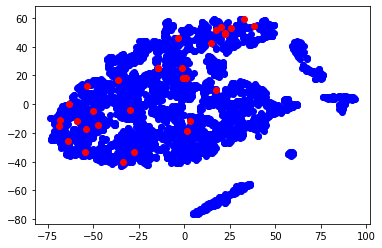

In [191]:
plt.scatter(vis_mod[target_tst==0][:,0], vis_mod[target_tst==0][:,1], c='b')
plt.scatter(vis_mod[target_tst==1][:,0], vis_mod[target_tst==1][:,1], c='r')
plt.show()